# Mapping Depth of the Sky with quality conditions applied

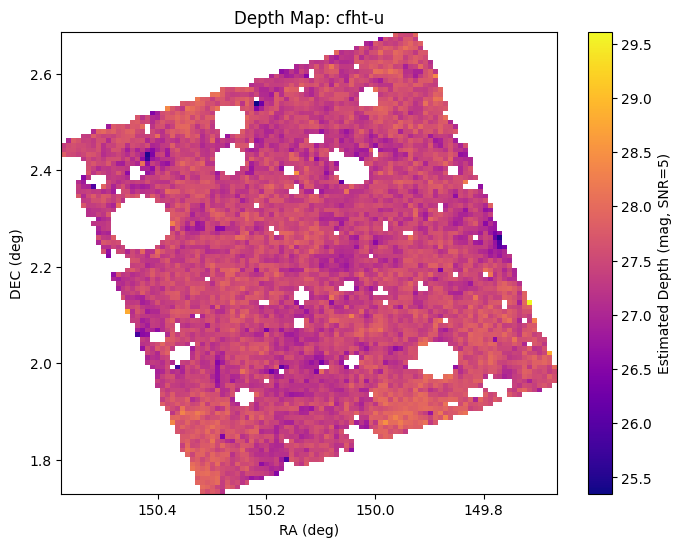

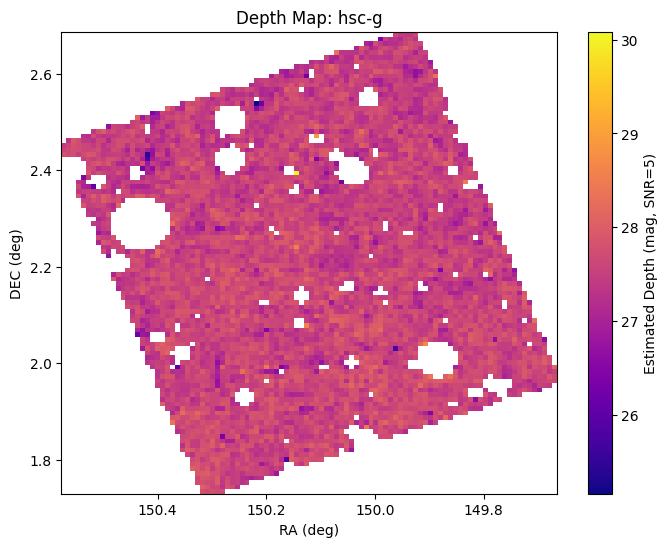

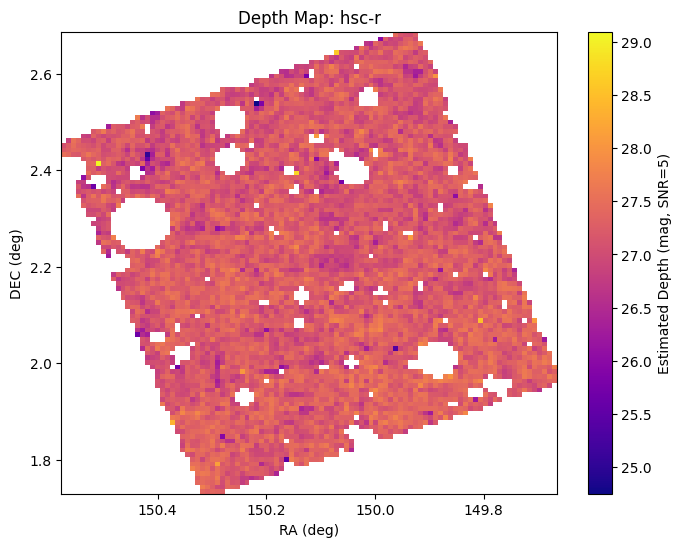

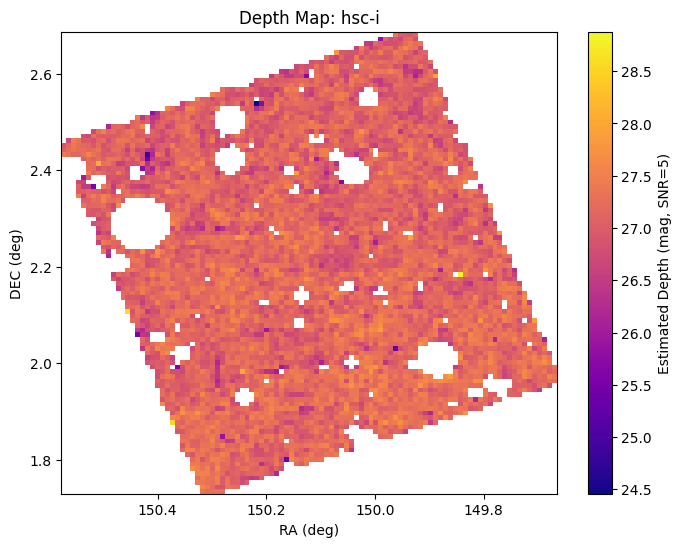

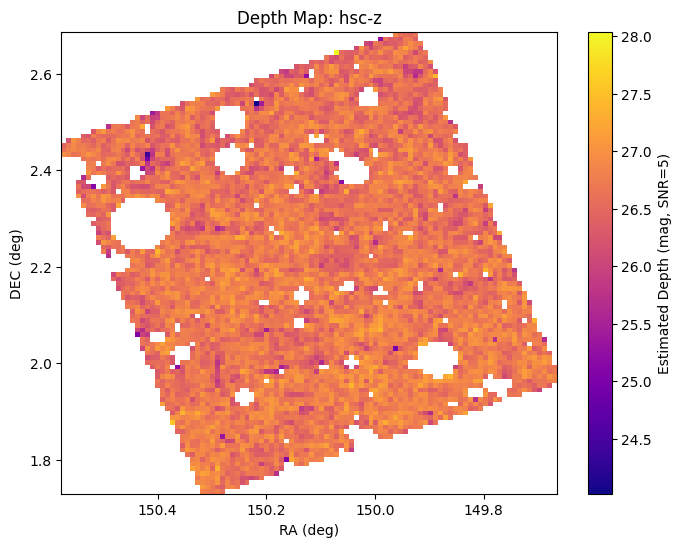

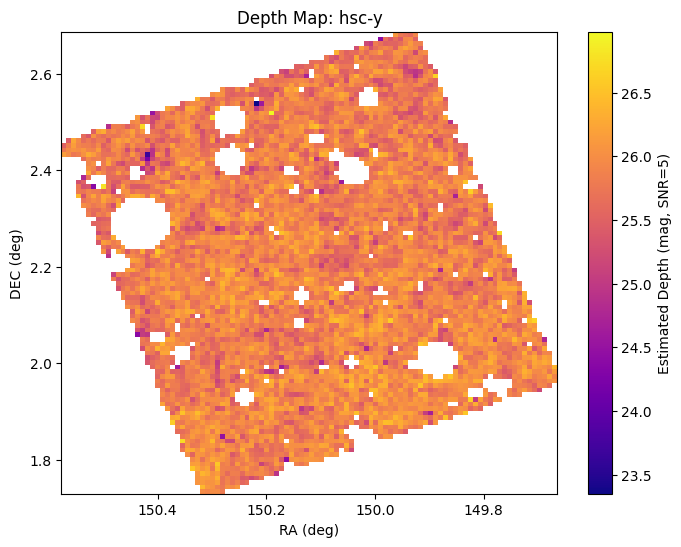

In [4]:
import matplotlib.pyplot as plt
from astropy.table import Table
from scipy.stats import binned_statistic_2d
import numpy as np

# Load catalogs
filepath = "C:/Users/sahil/Downloads/COSMOSWeb_mastercatalog_v1.fits"
cat_photom = Table.read(filepath, hdu=1)
cat_lephare = Table.read(filepath, hdu=2)

# Clean condition
condition_clean = np.logical_and.reduce((
    cat_lephare['type'] == 0,             # galaxies only
    cat_photom['warn_flag'] == 0,         # no warnings
    cat_photom['flag_star_hsc'] == 0      # not in bright star mask
))

# Extract RA, DEC of cleaned catalog
ra = cat_photom['ra'][condition_clean]
dec = cat_photom['dec'][condition_clean]

# Bands of interest
bands = ['cfht-u', 'hsc-g', 'hsc-r', 'hsc-i', 'hsc-z', 'hsc-y']

# Constants
s = 1.0857
n_bins = 100  # sky binning

for band in bands:
    mag_col = f'mag_model_{band}'
    err_col = f'mag_err_model_{band}'
    
    if (mag_col not in cat_photom.colnames) or (err_col not in cat_photom.colnames):
        print(f"{band}: missing columns — skipping")
        continue
    
    # Apply clean mask to mags and errors
    mag = cat_photom[mag_col][condition_clean]
    mag_err = cat_photom[err_col][condition_clean]

    # Further mask to ensure valid values
    mask = (mag > 0) & (mag < 90) & (mag_err > 0) & (mag_err < 10)
    ra_valid = ra[mask]
    dec_valid = dec[mask]
    mag_valid = mag[mask]
    mag_err_valid = mag_err[mask]

    # Compute depth (5σ)
    nsr = mag_err_valid / s
    snr = 1 / nsr
    mdepth = mag_valid - 2.5 * np.log10(5 / snr)

    # Bin RA, DEC with mean depth
    stat, x_edges, y_edges, _ = binned_statistic_2d(
        ra_valid, dec_valid, mdepth,
        statistic='mean', bins=n_bins
    )

    # Plot
    plt.figure(figsize=(8, 6))
    plt.imshow(
        stat.T,
        origin='lower',
        extent=[x_edges[0], x_edges[-1], y_edges[0], y_edges[-1]],
        cmap='plasma',
        aspect='auto'
    )
    cb = plt.colorbar()
    cb.set_label('Estimated Depth (mag, SNR=5)')
    plt.xlabel('RA (deg)')
    plt.ylabel('DEC (deg)')
    plt.title(f'Depth Map: {band}')
    plt.gca().invert_xaxis()
    plt.show()


# Also Mapping the Source Count in the Survey

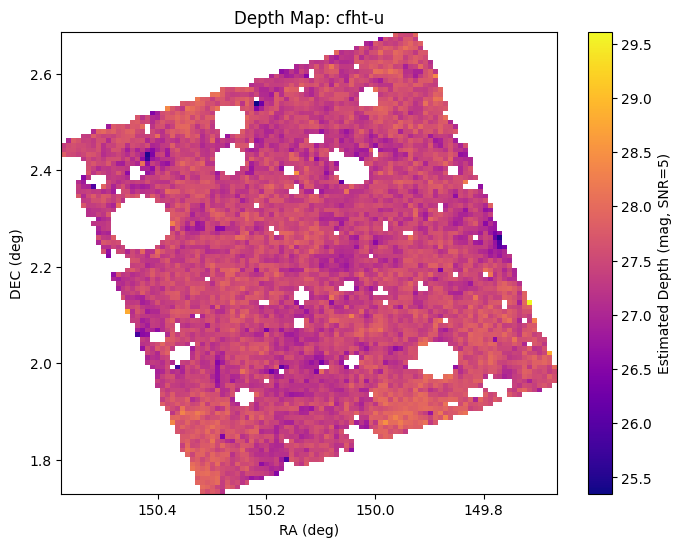

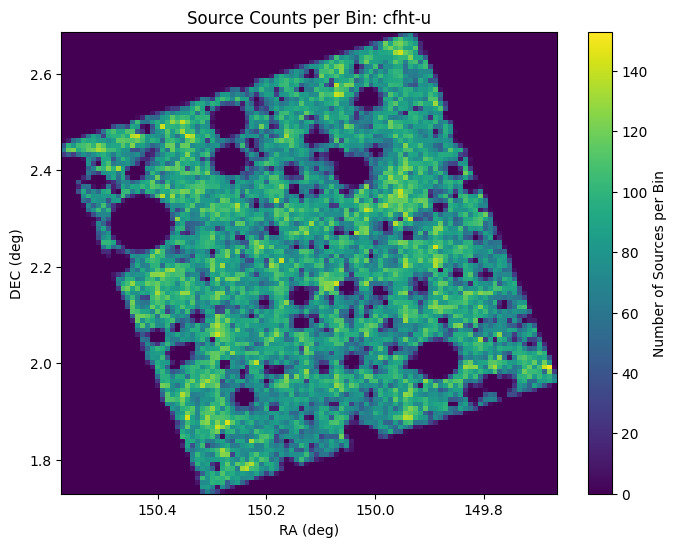

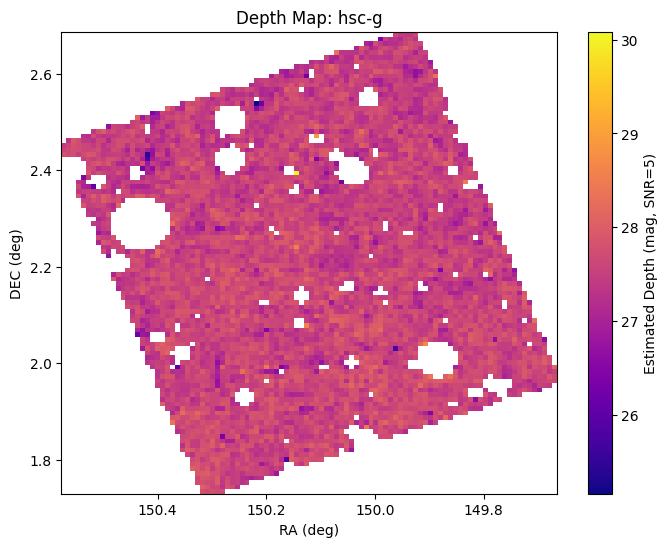

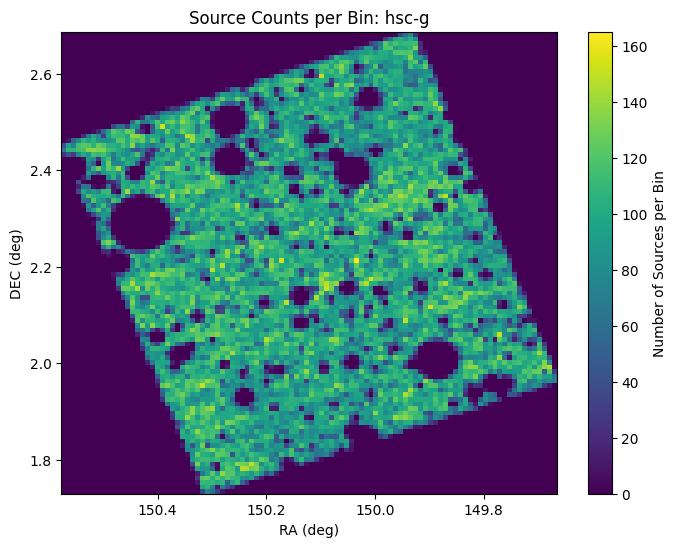

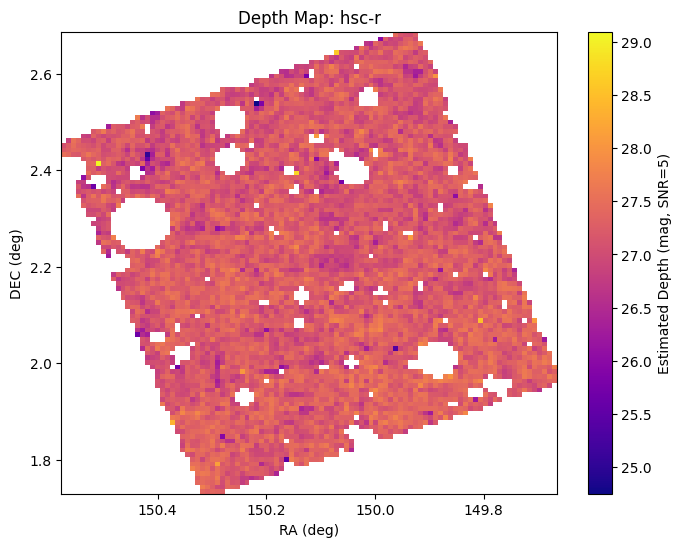

...

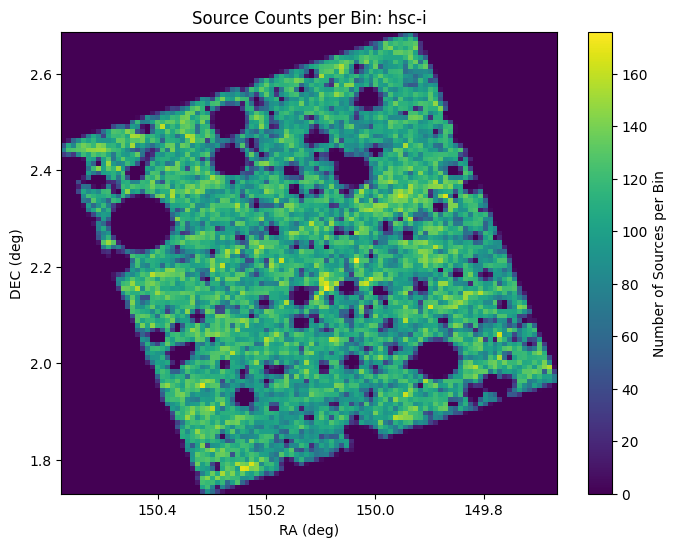

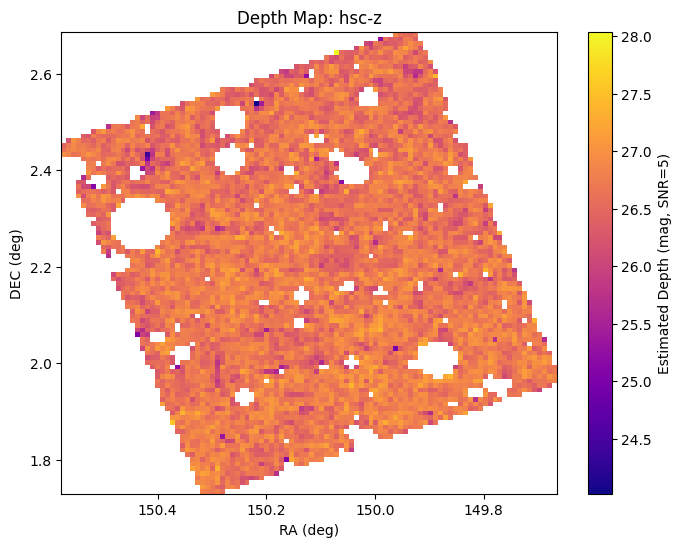

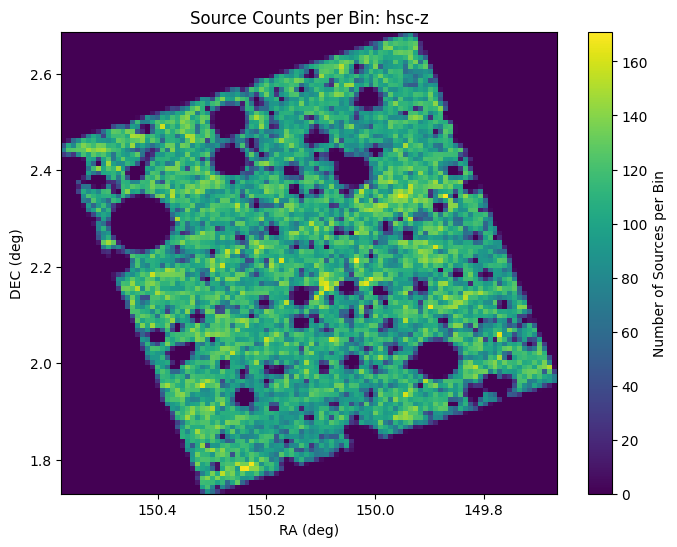

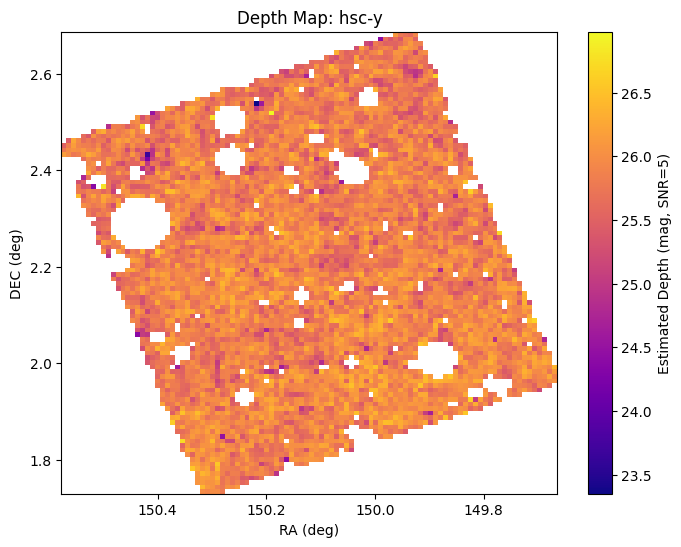

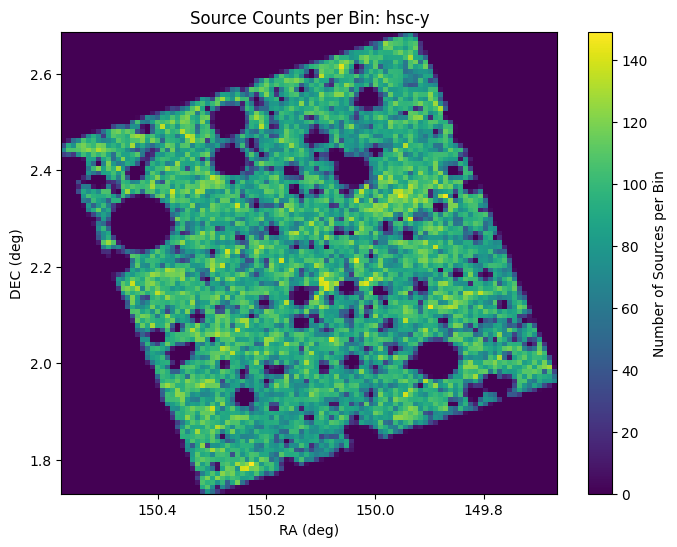

In [5]:
import matplotlib.pyplot as plt
from astropy.table import Table
from scipy.stats import binned_statistic_2d
import numpy as np

# Load catalogs
filepath = "C:/Users/sahil/Downloads/COSMOSWeb_mastercatalog_v1.fits"
cat_photom = Table.read(filepath, hdu=1)
cat_lephare = Table.read(filepath, hdu=2)

# Clean condition
condition_clean = np.logical_and.reduce((
    cat_lephare['type'] == 0,             # galaxies only
    cat_photom['warn_flag'] == 0,         # no warnings
    cat_photom['flag_star_hsc'] == 0      # not in bright star mask
))

# Extract RA, DEC of cleaned catalog
ra = cat_photom['ra'][condition_clean]
dec = cat_photom['dec'][condition_clean]

# Bands of interest
bands = ['cfht-u', 'hsc-g', 'hsc-r', 'hsc-i', 'hsc-z', 'hsc-y']

# Constants
s = 1.0857
n_bins = 100  # sky binning

for band in bands:
    mag_col = f'mag_model_{band}'
    err_col = f'mag_err_model_{band}'
    
    if (mag_col not in cat_photom.colnames) or (err_col not in cat_photom.colnames):
        print(f"{band}: missing columns — skipping")
        continue
    
    # Apply clean mask to mags and errors
    mag = cat_photom[mag_col][condition_clean]
    mag_err = cat_photom[err_col][condition_clean]

    # Further mask to ensure valid values
    mask = (mag > 0) & (mag < 90) & (mag_err > 0) & (mag_err < 10)
    ra_valid = ra[mask]
    dec_valid = dec[mask]
    mag_valid = mag[mask]
    mag_err_valid = mag_err[mask]

    # Compute depth (5σ)
    nsr = mag_err_valid / s
    snr = 1 / nsr
    mdepth = mag_valid - 2.5 * np.log10(5 / snr)

    # Bin RA, DEC with mean depth
    depth_stat, x_edges, y_edges, _ = binned_statistic_2d(
        ra_valid, dec_valid, mdepth,
        statistic='mean', bins=n_bins
    )

    # Bin RA, DEC with counts
    count_stat, _, _, _ = binned_statistic_2d(
        ra_valid, dec_valid, None,  # no values, just counts
        statistic='count', bins=[x_edges, y_edges]
    )

    # --- Plot depth map ---
    plt.figure(figsize=(8, 6))
    plt.imshow(
        depth_stat.T,
        origin='lower',
        extent=[x_edges[0], x_edges[-1], y_edges[0], y_edges[-1]],
        cmap='plasma',
        aspect='auto'
    )
    cb = plt.colorbar()
    cb.set_label('Estimated Depth (mag, SNR=5)')
    plt.xlabel('RA (deg)')
    plt.ylabel('DEC (deg)')
    plt.title(f'Depth Map: {band}')
    plt.gca().invert_xaxis()
    plt.show()

    # --- Plot counts map ---
    plt.figure(figsize=(8, 6))
    plt.imshow(
        count_stat.T,
        origin='lower',
        extent=[x_edges[0], x_edges[-1], y_edges[0], y_edges[-1]],
        cmap='viridis',
        aspect='auto'
    )
    cb = plt.colorbar()
    cb.set_label('Number of Sources per Bin')
    plt.xlabel('RA (deg)')
    plt.ylabel('DEC (deg)')
    plt.title(f'Source Counts per Bin: {band}')
    plt.gca().invert_xaxis()
    plt.show()


In [6]:
import numpy as np
from astropy.table import Table
from scipy.stats import binned_statistic_2d

# Load catalogs
filepath = "C:/Users/sahil/Downloads/COSMOSWeb_mastercatalog_v1.fits"
cat_photom = Table.read(filepath, hdu=1)
cat_lephare = Table.read(filepath, hdu=2)

# Clean condition
condition_clean = np.logical_and.reduce((
    cat_lephare['type'] == 0,             # galaxies only
    cat_photom['warn_flag'] == 0,         # no warnings
    cat_photom['flag_star_hsc'] == 0      # not in bright star mask
))

# Extract IDs, RA, DEC, mag, mag_err for one band (e.g., hsc-i)
ids = cat_photom['id'][condition_clean]
ra = cat_photom['ra'][condition_clean]
dec = cat_photom['dec'][condition_clean]
mag = cat_photom['mag_model_hsc-i'][condition_clean]
mag_err = cat_photom['mag_err_model_hsc-i'][condition_clean]

# Mask valid values
mask = (mag > 0) & (mag < 90) & (mag_err > 0) & (mag_err < 10)
ids = ids[mask]
ra = ra[mask]
dec = dec[mask]
mag = mag[mask]
mag_err = mag_err[mask]

# Compute depth per source
s = 1.0857
nsr = mag_err / s
snr = 1 / nsr
mdepth = mag - 2.5 * np.log10(5 / snr)

# Bin edges
n_bins = 100
stat, x_edges, y_edges, binnumber = binned_statistic_2d(
    ra, dec, mdepth,
    statistic='mean', bins=n_bins, expand_binnumbers=True
)

# Map each source to its bin depth
source_to_m5 = {}
for i, sid in enumerate(ids):
    # bin indices for this source
    bx, by = binnumber[0][i]-1, binnumber[1][i]-1
    # get depth value from stat grid
    m5_val = stat[bx, by] if (0 <= bx < stat.shape[0] and 0 <= by < stat.shape[1]) else np.nan
    source_to_m5[int(sid)] = float(m5_val)

# Example: print first 5 mappings
for k in list(source_to_m5.keys()):
    print(k, "->", source_to_m5[k])


0 -> 27.153242894595575
1 -> 27.153242894595575
2 -> 27.20485636494541
3 -> 27.465341174755576
4 -> 26.953070255672095
5 -> 26.67181183924045
7 -> 27.01404607485874
8 -> 27.136771307646004
9 -> 27.488602812309054
10 -> 27.242976900509166
11 -> 27.242976900509166
12 -> 26.820386262306418
13 -> 26.7105077257357
14 -> 27.308782121070045
15 -> 26.857216404557725
16 -> 27.435496840039594
17 -> 26.820386262306418
18 -> 27.488602812309054
19 -> 27.136771307646004
20 -> 26.7105077257357
21 -> 27.488602812309054
22 -> 27.01404607485874
23 -> 27.435496840039594
25 -> 26.67181183924045
26 -> 27.18276408148637
27 -> 26.67181183924045
28 -> 27.18276408148637
29 -> 26.975669321356623
30 -> 27.136771307646004
31 -> 26.7105077257357
32 -> 27.308782121070045
33 -> 26.857216404557725
34 -> 27.435496840039594
35 -> 27.136771307646004
36 -> 27.20099859769688
38 -> 26.7105077257357
39 -> 27.01404607485874
40 -> 27.136771307646004
41 -> 27.136771307646004
42 -> 27.136771307646004
43 -> 27.488602812309054
44

# Creating A dictionary to map all the sources to their regional m5 value

In [136]:
bands = ['cfht-u', 'hsc-g', 'hsc-r', 'hsc-i', 'hsc-z', 'hsc-y']
n_bins = 100
s = 1.0857

# Clean condition
condition_clean = np.logical_and.reduce((
    cat_lephare['type'] == 0,             # galaxies only
    cat_photom['warn_flag'] == 0,         # no warnings
    np.abs(cat_photom['mag_model_f444w']) < 30,  # not extremely faint
    cat_photom['flag_star_hsc'] == 0      # not in bright star mask
))

all_source_to_m5 = {band: {} for band in bands}

for band in bands:
    mag_col = f'mag_model_{band}'
    err_col = f'mag_err_model_{band}'

    if (mag_col not in cat_photom.colnames) or (err_col not in cat_photom.colnames):
        print(f"{band}: missing columns — skipping")
        continue

    # Extract
    ids = cat_photom['id'][condition_clean]
    ra = cat_photom['ra'][condition_clean]
    dec = cat_photom['dec'][condition_clean]
    mag = cat_photom[mag_col][condition_clean]
    mag_err = cat_photom[err_col][condition_clean]

    # Mask valid
    mask = (mag > 0) & (mag < 99) & (mag_err > 0) & (np.isfinite(mag_err))
    ids = ids[mask]
    ra = ra[mask]
    dec = dec[mask]
    mag = mag[mask]
    mag_err = mag_err[mask]

    # Depth
    nsr = mag_err / s
    snr = 1 / nsr
    mdepth = mag - 2.5 * np.log10(5 / snr)

    # Bin and assign
    stat, x_edges, y_edges, binnumber = binned_statistic_2d(
        ra, dec, mdepth,
        statistic='mean', bins=n_bins, expand_binnumbers=True
    )

    for i, sid in enumerate(ids):
        bx, by = binnumber[0][i]-1, binnumber[1][i]-1
        m5_val = stat[bx, by] if (0 <= bx < stat.shape[0] and 0 <= by < stat.shape[1]) else np.nan
        all_source_to_m5[band][int(sid)] = float(m5_val)

# Example: print some results
for band in all_source_to_m5:
    sample_items = list(all_source_to_m5[band].items())[:3]
    print(f"{band}:", sample_items)


KeyboardInterrupt: 

# So you dont have to run the above code again - creates a dictionary to save and access these values  

In [8]:
import pickle

# Save
with open("all_source_to_m5.pkl", "wb") as f:
    pickle.dump(source_to_m5, f)

# Load back
with open("all_source_to_m5.pkl", "rb") as f:
    loaded_dict = pickle.load(f)

print("Saved and reloaded pickle with", len(loaded_dict), "entries")


Saved and reloaded pickle with 547400 entries


# Just to select nbin for the previous

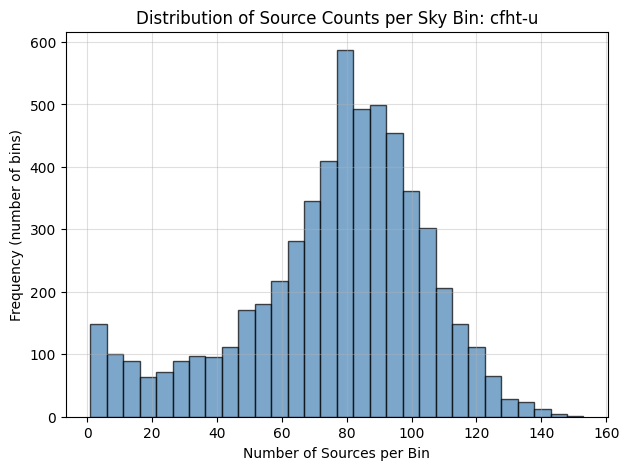

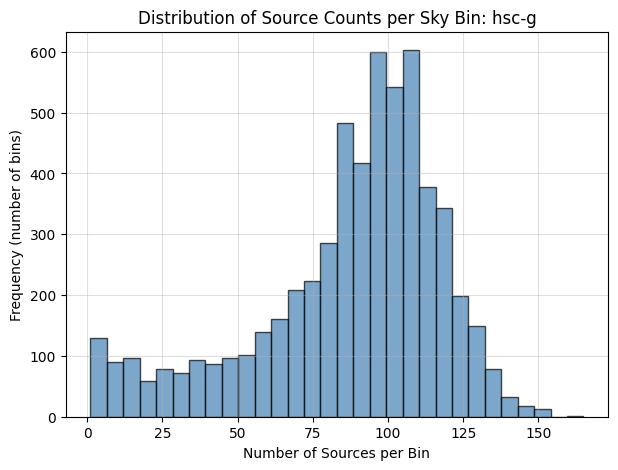

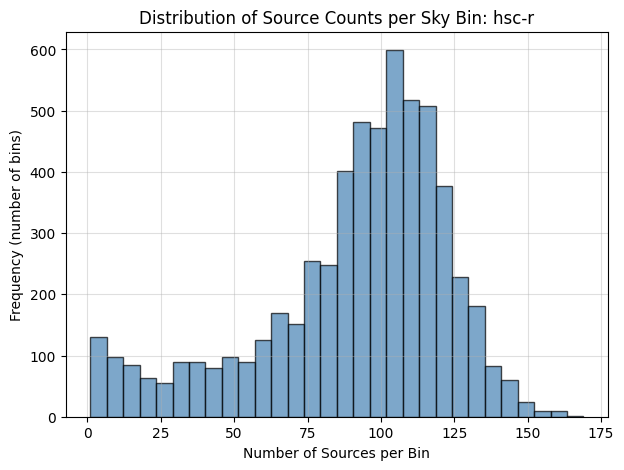

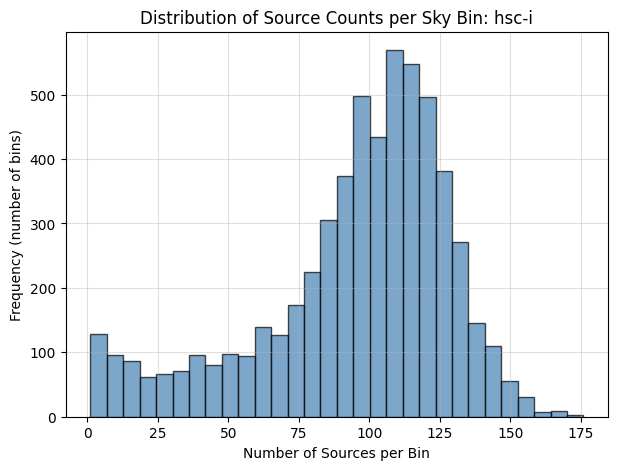

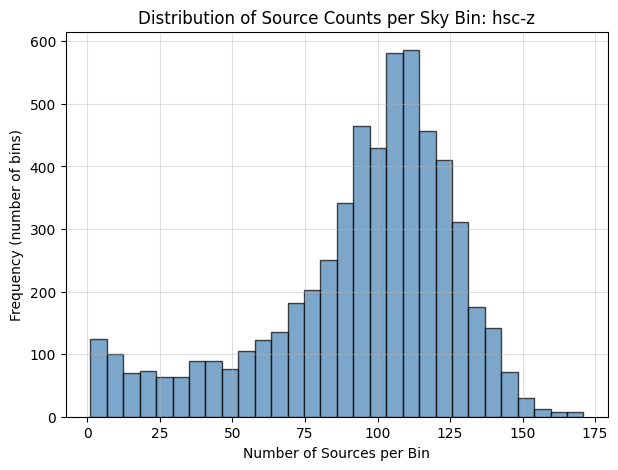

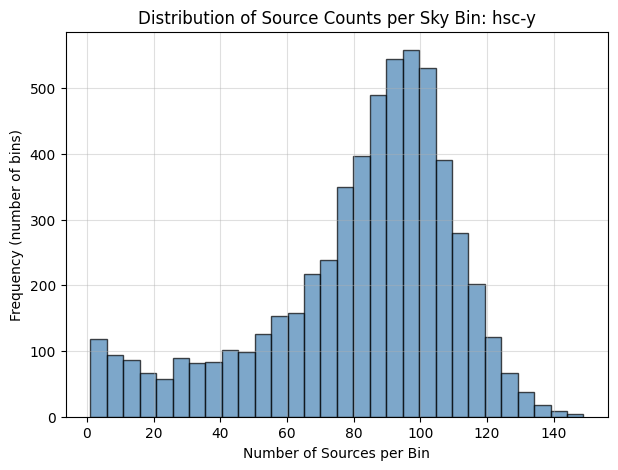

In [9]:
import matplotlib.pyplot as plt
from astropy.table import Table
from scipy.stats import binned_statistic_2d
import numpy as np

# Load catalogs
filepath = "C:/Users/sahil/Downloads/COSMOSWeb_mastercatalog_v1.fits"
cat_photom = Table.read(filepath, hdu=1)
cat_lephare = Table.read(filepath, hdu=2)

# Clean condition
condition_clean = np.logical_and.reduce((
    cat_lephare['type'] == 0,             # galaxies only
    cat_photom['warn_flag'] == 0,         # no warnings
    cat_photom['flag_star_hsc'] == 0      # not in bright star mask
))

# Extract RA, DEC of cleaned catalog
ra = cat_photom['ra'][condition_clean]
dec = cat_photom['dec'][condition_clean]

# Bands of interest
bands = ['cfht-u', 'hsc-g', 'hsc-r', 'hsc-i', 'hsc-z', 'hsc-y']

# Constants
s = 1.0857
n_bins = 100  # sky binning

for band in bands:
    mag_col = f'mag_model_{band}'
    err_col = f'mag_err_model_{band}'
    
    if (mag_col not in cat_photom.colnames) or (err_col not in cat_photom.colnames):
        print(f"{band}: missing columns — skipping")
        continue
    
    # Apply clean mask to mags and errors
    mag = cat_photom[mag_col][condition_clean]
    mag_err = cat_photom[err_col][condition_clean]

    # Further mask to ensure valid values
    mask = (mag > 0) & (mag < 90) & (mag_err > 0) & (np.isfinite(mag_err))
    ra_valid = ra[mask]
    dec_valid = dec[mask]
    mag_valid = mag[mask]
    mag_err_valid = mag_err[mask]

    # Compute depth (5σ)
    nsr = mag_err_valid / s
    snr = 1 / nsr
    mdepth = mag_valid - 2.5 * np.log10(5 / snr)

    # Bin RA, DEC with counts
    count_stat, x_edges, y_edges, _ = binned_statistic_2d(
        ra_valid, dec_valid, None,  # no values, just counts
        statistic='count', bins=n_bins
    )

    # Flatten counts, ignoring empty bins (0 sources)
    counts_flat = count_stat.flatten()
    counts_flat = counts_flat[counts_flat > 0]

    # Plot histogram
    plt.figure(figsize=(7,5))
    plt.hist(counts_flat, bins=30, color="steelblue", alpha=0.7, edgecolor="black")
    plt.xlabel("Number of Sources per Bin")
    plt.ylabel("Frequency (number of bins)")
    plt.title(f"Distribution of Source Counts per Sky Bin: {band}")
    plt.grid(True, alpha=0.4)
    plt.show()


# To extract the data from the databases / .spec files 
- Takes ages to run. Dont run if the compiled datafiles are available which I will provide. 

In [ ]:
import numpy as np 
import os 

def load_lephare_bandmags_header(source_id, lephare_root):
    """
    Read the band-integrated model magnitudes from lines ~14–50 of a LePhare .spec file.
    Returns arrays: lam_um, mag, err, width_um, flag, limmag
    """

    spec_filename = os.path.join(lephare_root, "LePHARE_SEDs_v1", f"Id{source_id}.0.spec")
    
    if not os.path.exists(spec_filename):
        return tuple([np.array([]) for _ in range(6)])

    with open(spec_filename, "r") as f:
        lines = f.readlines()

    lam_um, mag, err, width_um, flag, limmag = [], [], [], [], [], []
    # Python indices 13..50 cover the header band table (1-indexed ~14..50)
    for line in lines[13:50]:
        parts = line.split()
        if len(parts) < 9:
            continue
        m, e, lamA, widthA, _, _, _, flg, lmag = parts
        # Skip placeholder "1000 1000" style rows (non-computable)
        if float(m) >= 900 or float(e) >= 900:
            continue
        lam_um.append(float(lamA) / 1e4)
        mag.append(float(m))
        err.append(float(e))
        width_um.append(float(widthA) / 1e4)
        flag.append(int(flg))
        limmag.append(float(lmag))

    return (np.array(lam_um), np.array(mag), np.array(err),
            np.array(width_um), np.array(flag), np.array(limmag))

In [11]:
import numpy as np
from tqdm import tqdm
from astropy.table import Table

# --- Load catalog ---
cat_photom = Table.read("COSMOSWeb_mastercatalog_v1.fits", hdu=1)
cat_photom = cat_photom[::10]  # subsample for testing


# --- Collect noiseless magnitudes + uncertainties from .spec headers ---
def collect_noiseless_mags_and_errs(cat_photom, lephare_root, source_ids, target_bands,
                                    log_every=100, show_progress=True):
    mags_by_band = {b: {"ids": [], "values": []} for b in target_bands.keys()}
    errs_by_band = {b: {"ids": [], "values": []} for b in target_bands.keys()}

    n_total, n_used, n_missing = len(source_ids), 0, 0
    iterator = tqdm(source_ids, desc="Collecting noiseless mags+errs", unit="src") if show_progress else source_ids

    for i, sid in enumerate(iterator, 1):
        row_mask = (
            (cat_photom['id'] == sid) &
            (cat_photom['warn_flag'] == 0) &
            (cat_photom['flag_star_hsc'] == 0)
        )
        if not np.any(row_mask):
            continue

        # load LePhare header mags + errs
        lam_um_hdr, mag_hdr, err_hdr, width_um_hdr, flag_hdr, limmag_hdr = \
            load_lephare_bandmags_header(sid, lephare_root)
        if lam_um_hdr.size == 0:
            n_missing += 1
            continue
        n_used += 1

        # match requested bands
        for band, lam_eff in target_bands.items():
            idx = int(np.argmin(np.abs(lam_um_hdr - lam_eff)))
            m_mod = float(mag_hdr[idx])
            e_mod = float(err_hdr[idx])
            if np.isfinite(m_mod) and (0.0 < m_mod < 99.0) and np.isfinite(e_mod) and e_mod > 0:
                mags_by_band[band]["ids"].append(int(sid))
                mags_by_band[band]["values"].append(m_mod)
                errs_by_band[band]["ids"].append(int(sid))
                errs_by_band[band]["values"].append(e_mod)

        if (not show_progress) and (i % log_every == 0):
            print(f"[{i}/{n_total}] processed")

    # convert to numpy arrays
    for b in mags_by_band:
        mags_by_band[b]["ids"] = np.array(mags_by_band[b]["ids"], dtype=int)
        mags_by_band[b]["values"] = np.array(mags_by_band[b]["values"], dtype=float)
        errs_by_band[b]["ids"] = np.array(errs_by_band[b]["ids"], dtype=int)
        errs_by_band[b]["values"] = np.array(errs_by_band[b]["values"], dtype=float)

    print(f"Done. total={n_total}, used={n_used}, missing_header={n_missing}")
    return mags_by_band, errs_by_band


# --- Collect noisy observed magnitudes + flux uncertainties from catalog ---
def collect_noisy_mags_and_fluxerrs(cat_photom, target_bands):
    noisy_mags = {b: {"ids": [], "values": []} for b in target_bands.keys()}
    flux_errs = {b: {"ids": [], "values": []} for b in target_bands.keys()}

    for band in target_bands.keys():
        mag_col = f"mag_model_{band}"
        fluxerr_col = f"flux_err-cal_model_{band}"  # correct column name

        if mag_col in cat_photom.colnames and fluxerr_col in cat_photom.colnames:
            mags = np.array(cat_photom[mag_col])
            f_errs = np.array(cat_photom[fluxerr_col])
            ids = np.array(cat_photom["id"])

            # apply finite + reasonable cut
            mask = (mags > 0) & (mags < 99) & np.isfinite(f_errs) & (f_errs > 0)
            noisy_mags[band]["ids"] = ids[mask]
            noisy_mags[band]["values"] = mags[mask]
            flux_errs[band]["ids"] = ids[mask]
            flux_errs[band]["values"] = f_errs[mask]
        else:
            print(f"Warning: {mag_col} or {fluxerr_col} not found in catalog")

    return noisy_mags, flux_errs


# === Example usage ===
TARGET_BANDS = {
    "cfht-u": 0.38,
    "hsc-g": 0.48,
    "hsc-r": 0.62,
    "hsc-i": 0.77,
    "hsc-z": 0.89,
    "hsc-y": 1.02,
}

lephare_root = r"C:\Users\sahil\Downloads\LePHARE_SEDs_v1\n23data2\cosmosweb\catalogs\Release_v1"
subset_ids = cat_photom['id']

# noiseless mags + uncertainties from .spec
noiseless_mags, noiseless_errs = collect_noiseless_mags_and_errs(
    cat_photom, lephare_root, subset_ids, TARGET_BANDS
)

# noisy mags + flux uncertainties from catalog
noisy_mags, flux_errs = collect_noisy_mags_and_fluxerrs(cat_photom, TARGET_BANDS)

# --- Combine into one dict with source IDs ---
all_data = {
    "noiseless_mags": noiseless_mags,
    "noiseless_errs": noiseless_errs,
    "noisy_mags": noisy_mags,
    "flux_errs": flux_errs,
}

# # Save all to one file
# np.save("cosmos_hsc_cfht_mags_all2.npy", all_data, allow_pickle=True)
# print("Saved everything (with source IDs) to cosmos_hsc_cfht_mags_all.npy")


KeyboardInterrupt: 

# After extraction - just to merge the lephare noiseless magnitudes with the noisy flux and error values using source id
- Also restructure it 

In [9]:
import numpy as np

# Load original dict
data = np.load("cosmos_hsc_cfht_mags_all2.npy", allow_pickle=True).item()

bands = data["noiseless_mags"].keys()

# New structure: per-band dictionary
band_struct = {}

for band in bands:
    # Extract IDs from all four sources
    ids_noiseless = set(data["noiseless_mags"][band]["ids"])
    ids_noiseless_errs = set(data["noiseless_errs"][band]["ids"])
    ids_noisy = set(data["noisy_mags"][band]["ids"])
    ids_fluxerr = set(data["flux_errs"][band]["ids"])

    # Common IDs across all
    common_ids = ids_noiseless & ids_noiseless_errs & ids_noisy & ids_fluxerr

    # If no overlap, skip
    if len(common_ids) == 0:
        continue

    # Map back from arrays
    def filter_vals(entry, ids_common):
        id_arr = np.array(entry["ids"])
        val_arr = np.array(entry["values"])
        mask = np.isin(id_arr, list(ids_common))
        return id_arr[mask], val_arr[mask]

    ids, noiseless_vals = filter_vals(data["noiseless_mags"][band], common_ids)
    _, noiseless_errs_vals = filter_vals(data["noiseless_errs"][band], common_ids)
    _, noisy_vals = filter_vals(data["noisy_mags"][band], common_ids)
    _, flux_errs_vals = filter_vals(data["flux_errs"][band], common_ids)

    # Store structured
    band_struct[band] = {
        "ids": ids,
        "noiseless_mags": noiseless_vals,
        "noiseless_errs": noiseless_errs_vals,
        "noisy_mags": noisy_vals,
        "flux_errs": flux_errs_vals,
    }

# Save restructured data
np.save("cosmos_hsc_cfht_bandwise.npy", band_struct, allow_pickle=True)
print("Saved band-wise structured dataset with matched IDs.")


Saved band-wise structured dataset with matched IDs.


# Flowfusion diffusion learning model - I copy pasted the relevant code instead of installing the module 

In [10]:
import numpy as np
import torch
import torch.func
from torch.distributions import Normal
from torchdiffeq import odeint, odeint_adjoint
from tqdm import tqdm


class MLP(torch.nn.Module):
    """
    Multilayer perceptron for learning the score function
    """

    def __init__(
        self,
        n_dimensions=2,
        n_conditionals=1,
        embedding_dimensions=8,
        units=[128],
        activation=torch.nn.SiLU(),
        sigma_initialization=16,
    ):
        super().__init__()

        self.n_dimensions = n_dimensions
        self.n_conditionals = n_conditionals
        self.architecture = (
            [n_dimensions + n_conditionals + embedding_dimensions]
            + units
            + [n_dimensions]
        )
        self.n_layers = len(self.architecture) - 1
        self.NN = torch.nn.ModuleList(
            [
                torch.nn.Linear(self.architecture[layer], self.architecture[layer + 1])
                for layer in range(self.n_layers)
            ]
        )
        self.W = torch.nn.Parameter(
            torch.randn(embedding_dimensions // 2) * sigma_initialization,
            requires_grad=False,
        )
        self.activation = activation

        # pi
        self.register_buffer("pi", torch.tensor(np.pi, dtype=torch.float32))

    def forward(self, t, x, conditional=None):
        """
        Forward call to the MLP
        """
        # concatenate the conditional inputs
        if conditional is not None:
            x = torch.cat([x, conditional], dim=1)

        # ensure t is a tensor
        if t.size() == torch.Size([]):
            t = t * torch.ones(x.shape[:-1]).to(x.device)

        # time ebmedding
        t_projected = t[:, None] * self.W[None, :] * 2 * self.pi
        t_embedded = torch.cat([torch.sin(t_projected), torch.cos(t_projected)], dim=1)

        # concatenated inputs
        x = torch.cat([t_embedded, x], dim=1)

        # forward pass through layers
        for layer in range(self.n_layers - 1):
            x = self.NN[layer](x)
            x = self.activation(x)
        x = self.NN[-1](x)

        return x


class ScoreModel(torch.nn.Module):
    """
    Score-based generative model that learns the score function of any given data distribution and generates samples by reversing an ODE/SDE
    """

    def __init__(
        self, model=None, sde=None, conditional=None, no_sigma=False, hutchinson=False
    ):
        super().__init__()

        # model assumed to return: score(x, t, conditional) if no_sigma is True
        # model assumed to return: score(x, t, conditional) * sigma(t) if no_sigma is False
        self.model = model  # see above
        self.sde = sde
        self.conditional = conditional  # stores the conditioning variable
        self.no_sigma = (
            no_sigma  # if True, drops the 1/sigma(t) in the score definition
        )
        self.prob = False
        self.hutch = hutchinson  # if True, uses the Hutchinson trace estimator

    def score(self, t, x, conditional=None):
        if self.no_sigma:
            return self.model(t, x, conditional=conditional)

        return self.model(t, x, conditional=conditional) / self.sde.sigma(t).view(
            -1, *[1] * len(x.shape[1:])
        )

    def loss_fn(self, x, conditional=None):
        return denoising_score_matching(self, x, conditional=conditional)

    def ode_drift(self, t, x, conditional=None):
        f = self.sde.drift(t, x)
        g = self.sde.diffusion(t, x)
        f_tilde = f - 0.5 * g**2 * self.score(t, x, conditional=conditional)
        return f_tilde

    def forward(self, t, states):

        # extract x and batch size
        x = states[0]
        batchsize = x.shape[0]

        # compute derivatives of x
        with torch.set_grad_enabled(True):
            x.requires_grad_(True)
            t.requires_grad_(True)

            # Calculate the time derivative of x.
            x_dot = self.ode_drift(t, x, conditional=self.conditional)

            # Calculate the time derivative of the log determinant of the Jacobian.
            if self.prob is True:
                if self.hutch is False:
                    # Define a helper function to compute the trace of the Jacobian for a single sample.
                    def get_trace_of_jacobian(x_sample, cond_sample):
                        # Define the function whose Jacobian we want.
                        def f(x_in):
                            # Unsqueeze inputs for the model, which expects a batch dimension.
                            cond_in = cond_sample.unsqueeze(0) if cond_sample is not None else None
                            x_in_batched = x_in.unsqueeze(0)
                            
                            # Calculate the drift for the single, now-batched sample.
                            drift = self.ode_drift(t, x_in_batched, conditional=cond_in)
                            
                            # Squeeze the batch dimension from the output to match input shape.
                            return drift.squeeze(0)

                        # Compute the Jacobian of f w.r.t x_sample and return its trace.
                        return torch.trace(torch.func.jacrev(f)(x_sample))

                    #Vectorize the helper function over the batch using vmap.
                    in_dims = (0, 0) if self.conditional is not None else (0, None)
                    divergence = torch.vmap(get_trace_of_jacobian, in_dims=in_dims)(x, self.conditional)
                else:
                    divergence = torch.sum(
                        torch.autograd.grad(
                            x_dot, x, self.e, create_graph=True, retain_graph=True
                        )[0]
                        * self.e,
                        dim=1,
                    )

        if self.prob is True:
            return x_dot, divergence.view(batchsize, 1)
        else:
            return x_dot

    @torch.no_grad()
    def sample_sde(self, shape, conditional=None, steps=100):
        """
        An Euler-Maruyama integration of the model SDE

        shape: Shape of the tensor to sample (including batch size)
        steps: Number of Euler-Maruyam steps to perform
        likelihood_score_fn: Add an additional drift to the sampling for posterior sampling. Must have the signature f(t, x)
        guidance_factor: Multiplicative factor for the likelihood drift
        """
        batch, *dims = shape

        # prior samples
        x = (
            self.sde.prior(dims)
            .sample([batch])
            .to(next(self.model.parameters()).device)
        )

        # time step and grid
        dt = -(self.sde.T - self.sde.epsilon) / steps
        t = torch.ones(batch).to(next(self.model.parameters()).device) * self.sde.T

        # loop over SDE time steps
        for _ in (pbar := tqdm(range(steps))):
            pbar.set_description(
                f"Sampling from the prior | t = {t[0].item():.1f} | sigma = {self.sde.sigma(t)[0].item():.1e}"
                f"| scale ~ {x.max().item():.1e}"
            )
            t += dt
            if (
                t[0] < self.sde.epsilon
            ):  # Accounts for numerical error in the way we discretize t.
                break
            g = self.sde.diffusion(t, x)
            f = self.sde.drift(t, x) - g**2 * self.score(t, x, conditional=conditional)
            dw = torch.randn_like(x).to(next(self.model.parameters()).device) * (
                -dt
            ) ** (1.0 / 2.0)
            x_mean = x + f * dt
            x = x_mean + g * dw
            if torch.any(torch.isnan(x)):
                print("Diffusion is not stable, NaN were produced. Stopped sampling.")
                break
        return x_mean

    # @torch.no_grad()
    def sample_ode_from_base(
        self,
        base_samples,
        conditional=None,
        atol=1e-4,
        rtol=1e-4,
        method="dopri5",
        options=None,
    ):

        # base samples (x(t))
        if hasattr(self.sde, "sigma_max"):
            z = base_samples * self.sde.sigma_max
        else:
            z = base_samples

        # integration times
        integration_times = torch.tensor([1.0, self.sde.epsilon]).to(z.device)

        # set prob to False
        self.prob = False

        # set the conditional if passed
        self.conditional = conditional

        # call to the ODE solver
        if self.training is True:
            state = odeint_adjoint(
                self,  # .forward() == time derivatives.
                (z,),  # state values to update.
                integration_times,  # when to evaluate.
                method=method,  # ode solver
                atol=atol,  # error tolerance
                rtol=rtol,  # error tolerance
                options=options,
            )
        else:
            state = odeint(
                self,  # .forward() == time derivatives.
                (z,),  # state values to update.
                integration_times,  # when to evaluate.
                method=method,  # ode solver
                atol=atol,  # error tolerance
                rtol=rtol,  # error tolerance
                options=options,
            )
        return state[0][1, ...], []

    @torch.no_grad()
    def solve_odes_forward(
        self,
        x0_samples,
        conditional=None,
        atol=1e-5,
        rtol=1e-5,
        method="dopri5",
        options=None,
    ):
        """
        This solves the pair of ODEs forward in time to find the base x(t=T) samples and log probabilities associated with some input x(t=0) samples
        """

        # set prob to True
        self.prob = True

        # sample epsilons for the trace
        if self.hutch is True:
            self.e = torch.sign(torch.randn(x0_samples.shape)).to(x0_samples.device)

        # starting value of delta log px
        delta_logpx = torch.zeros(x0_samples.shape[0], 1).to(x0_samples.device)

        # integration times
        integration_times = torch.tensor([self.sde.epsilon, 1.0]).to(x0_samples.device)

        # set the conditional if passed
        self.conditional = conditional

        # call to the ODE solver
        if self.training is True:
            state = odeint_adjoint(
                self,
                (x0_samples, delta_logpx),  # state values to update.
                integration_times,  # when to evaluate.
                method=method,  # ode solver
                atol=atol,  # error tolerance
                rtol=rtol,  # error tolerance
                options=options,
            )
        else:
            state = odeint(
                self,
                (x0_samples, delta_logpx),  # state values to update.
                integration_times,  # when to evaluate.
                method=method,  # ode solver
                atol=atol,  # error tolerance
                rtol=rtol,  # error tolerance
                options=options,
            )

        return state[0][1, ...], state[1][1, ...]


class VESDE(torch.nn.Module):
    def __init__(self, sigma_min=1e-2, sigma_max=10.0, T=1.0, epsilon=1e-5):
        """
        Variance Exploding stochastic differential equation

        Args:
            sigma_min (float): The minimum value of the standard deviation of the noise term.
            sigma_max (float): The maximum value of the standard deviation of the noise term.
            T (float, optional): The time horizon for the VESDE. Defaults to 1.0.
        """
        super(VESDE, self).__init__()
        self.register_buffer("T", torch.tensor(T, dtype=torch.float32))
        self.register_buffer("epsilon", torch.tensor(epsilon, dtype=torch.float32))
        self.register_buffer("sigma_min", torch.tensor(sigma_min, dtype=torch.float32))
        self.register_buffer("sigma_max", torch.tensor(sigma_max, dtype=torch.float32))

    def sigma(self, t):
        return self.sigma_min * (self.sigma_max / self.sigma_min) ** (t / self.T)

    def diffusion(self, t, x):
        _, *dims = x.shape  # broadcast diffusion coefficient to x shape
        return self.sigma(t).view(-1, *[1] * len(dims)) * torch.sqrt(
            2 * (torch.log(self.sigma_max) - torch.log(self.sigma_min)) / self.T
        )

    def drift(self, t, x):
        return torch.zeros_like(x).to(x.device)

    def marginal_prob_scalars(self, t):
        return torch.ones_like(t).to(t.device), self.sigma(t)

    def marginal_prob(self, t, x):

        _, *dims = x.shape

        # marginal mean and sigma
        m_t, sigma_t = self.marginal_prob_scalars(t)
        mean = m_t.view(-1, *[1] * len(dims)) * x
        std = sigma_t.view(-1, *[1] * len(dims))

        return mean, std

    def sample_marginal(self, t, x0):
        """
        Sample from the marginal at time t given some initial condition x0
        """
        _, *dims = x0.shape

        # base random numbers
        z = torch.randn_like(x0).to(x0.device)

        # marginal mean and sigma
        mu_t, sigma_t = self.marginal_prob_scalars(t)

        return (
            mu_t.view(-1, *[1] * len(dims)) * x0
            + sigma_t.view(-1, *[1] * len(dims)) * z
        )

    def prior(self, shape, mu=None):
        """
        Technically, VESDE does not change the mean of the 0 temperature distribution,
        so I give the option to provide for more accuracy. In practice,
        sigma_max is chosen large enough to make this choice irrelevant
        """
        if mu is None:
            mu = torch.zeros(shape).to(self.T.device)
        else:
            assert mu.shape == shape
        return Normal(loc=mu, scale=self.sigma_max)


class VPSDE(torch.nn.Module):
    """
    Variance preserving stochastic differential equation.
    """

    def __init__(
        self,
        beta_min=0.1,
        beta_max=20,
        T=1.0,
        epsilon=1e-3,
    ):
        super(VPSDE, self).__init__()
        self.beta_min = beta_min
        self.beta_max = beta_max
        self.T = T
        self.register_buffer("epsilon", torch.tensor(epsilon, dtype=torch.float32))

    def beta(self, t):
        return self.beta_min + (self.beta_max - self.beta_min) * (t / self.T)

    def sigma(self, t):
        return self.marginal_prob_scalars(t)[1]

    def prior(self, shape):
        return Normal(loc=torch.zeros(shape).to(self.epsilon.device), scale=1.0)

    def diffusion(self, t, x):
        _, *dims = x.shape
        return torch.sqrt(self.beta(t)).view(-1, *[1] * len(dims))

    def drift(self, t, x):
        _, *dims = x.shape
        return -0.5 * self.beta(t).view(-1, *[1] * len(dims)) * x

    def marginal_prob_scalars(self, t):
        """
        See equation (33) in Song et al 2020. (https://arxiv.org/abs/2011.13456)
        """
        log_coeff = (
            0.5 * (self.beta_max - self.beta_min) * t**2 / self.T + self.beta_min * t
        )  # integral of b(t)
        std = torch.sqrt(1.0 - torch.exp(-log_coeff))
        return torch.exp(-0.5 * log_coeff), std

    def marginal_prob(self, t, x):
        _, *dims = x.shape
        m_t, sigma_t = self.marginal_prob_scalars(t)
        mean = m_t.view(-1, *[1] * len(dims)) * x
        std = sigma_t.view(-1, *[1] * len(dims))
        return mean, std


class SUBVPSDE(torch.nn.Module):
    """
    Sub-variance preserving stochastic differential equation.
    """

    def __init__(
        self,
        beta_min=0.1,
        beta_max=20,
        T=1.0,
        epsilon=1e-5,
    ):
        super(SUBVPSDE, self).__init__()
        self.beta_min = beta_min
        self.beta_max = beta_max
        self.T = T
        self.register_buffer("epsilon", torch.tensor(epsilon, dtype=torch.float32))

    def beta(self, t):
        return self.beta_min + (self.beta_max - self.beta_min) * (t / self.T)

    def sigma(self, t):
        return self.marginal_prob_scalars(t)[1]

    def prior(self, shape):
        return Normal(loc=torch.zeros(shape).to(self.epsilon.device), scale=1.0)

    def diffusion(self, t, x):
        _, *dims = x.shape
        return torch.sqrt(
            self.beta(t)
            * (
                1.0
                - torch.exp(
                    self.beta_min * t
                    + 0.5 * (self.beta_max - self.beta_min) * t**2 / self.T
                )
            )
        ).view(-1, *[1] * len(dims))

    def drift(self, t, x):
        _, *dims = x.shape
        return -0.5 * self.beta(t).view(-1, *[1] * len(dims)) * x

    def marginal_prob_scalars(self, t):
        """
        See equation (33) in Song et al 2020. (https://arxiv.org/abs/2011.13456)
        """
        log_coeff = (
            0.5 * (self.beta_max - self.beta_min) * t**2 / self.T + self.beta_min * t
        )  # integral of b(t)
        std = 1.0 - torch.exp(-log_coeff)
        mu = torch.exp(-0.5 * log_coeff)
        return mu, std

    def marginal_prob(self, t, x):
        _, *dims = x.shape
        m_t, sigma_t = self.marginal_prob_scalars(t)
        mean = m_t.view(-1, *[1] * len(dims)) * x
        std = sigma_t.view(-1, *[1] * len(dims))
        return mean, std


def denoising_score_matching(score_model, x, conditional=None):
    """
    Training function for the diffusion model with denoising score matching
    """

    batch, *dims = x.shape

    # gaussian random draws
    z = torch.randn_like(x).to(x.device)

    # draw times from [\epsilon, T]
    t = (
        torch.rand(batch).to(x.device) * (score_model.sde.T - score_model.sde.epsilon)
        + score_model.sde.epsilon
    )

    # means and std-deviations of the marginal
    mean, sigma = score_model.sde.marginal_prob(t, x)

    # de-noising score matching
    return (
        torch.sum(
            (
                z
                + sigma
                * score_model.score(t, mean + sigma * z, conditional=conditional)
            )
            ** 2
        )
        / batch
    )


def log_prob_score_matching(score_model, x, conditional=None):
    """
    Training function for the diffusion model with log-prob
    """

    batch, *dims = x.shape

    # gaussian random draws
    z = torch.randn_like(x).to(x.device)

    # draw times from [\epsilon, T]
    t = (
        torch.rand(batch).to(x.device) * (score_model.sde.T - score_model.sde.epsilon)
        + score_model.sde.epsilon
    )

    # diffusion coefficient
    g = score_model.sde.diffusion(t, x)
    # means and std-deviations of the marginal
    mean, sigma = score_model.sde.marginal_prob(t, x)

    # de-noising score matching
    return (
        torch.sum(
            (
                (g / sigma) * z
                + g * score_model.score(t, mean + sigma * z, conditional=conditional)
            )
            ** 2
        )
        / batch
    )


class PopulationModelDiffusion(torch.nn.Module):
    def __init__(
        self,
        model=None,
        sde=None,
        shift=None,
        scale=None,
        method="dopri5",
        no_sigma=False,
        hutchinson=False,
        options=None,
    ):
        """
        Diffusion model class without conditionals.
        """

        super(PopulationModelDiffusion, self).__init__()

        self.model = model
        self.sde = sde
        self.score_model = ScoreModel(
            model=self.model, sde=self.sde, hutchinson=hutchinson, no_sigma=no_sigma
        )
        self.register_buffer(
            "shift",
            (
                shift
                if shift is not None
                else torch.zeros(self.model.n_dimensions, dtype=torch.float32)
            ),
        )
        self.register_buffer(
            "scale",
            (
                scale
                if scale is not None
                else torch.ones(self.model.n_dimensions, dtype=torch.float32)
            ),
        )
        self.method = method
        self.options = options

    def forward(self, base_samples):

        return (
            self.score_model.sample_ode_from_base(
                base_samples,
                method=self.method,
                atol=1e-5,
                rtol=1e-5,
                options=self.options,
            )[0]
            * self.scale
            + self.shift
        )

    def sample_sde(self, shape, steps=100):

        return self.score_model.sample_sde(shape, steps=100) * self.scale + self.shift

    def log_prob(self, x, atol=1e-5, rtol=1e-5):
        # solve for base sample and delta log prob
        xT, lp = self.score_model.solve_odes_forward(
            (x - self.shift) / self.scale, atol=atol, rtol=rtol, options=self.options
        )

        # add log of the base density
        lp = lp + torch.sum(self.sde.prior(xT.shape).log_prob(xT), 1, keepdim=True)

        return lp


class PopulationModelDiffusionConditional(torch.nn.Module):
    """
    Diffusion model class with conditionals.
    """

    def __init__(
        self,
        model=None,
        sde=None,
        shift=None,
        scale=None,
        conditional_shift=None,
        conditional_scale=None,
        no_sigma=False,
        method="dopri5",
        options=None,
    ):

        super(PopulationModelDiffusionConditional, self).__init__()

        self.model = model
        self.sde = sde
        self.score_model = ScoreModel(model=self.model, sde=self.sde, no_sigma=no_sigma)
        self.register_buffer(
            "shift",
            (
                shift
                if shift is not None
                else torch.zeros(self.model.n_dimensions, dtype=torch.float32)
            ),
        )
        self.register_buffer(
            "scale",
            (
                scale
                if scale is not None
                else torch.ones(self.model.n_dimensions, dtype=torch.float32)
            ),
        )
        self.register_buffer(
            "conditional_shift",
            (
                conditional_shift
                if conditional_shift is not None
                else torch.zeros(self.model.n_conditionals, dtype=torch.float32)
            ),
        )
        self.register_buffer(
            "conditional_scale",
            (
                conditional_scale
                if conditional_scale is not None
                else torch.ones(self.model.n_conditionals, dtype=torch.float32)
            ),
        )
        self.options = options
        self.method = method

    def forward(self, base_samples, conditional=None):

        return (
            self.score_model.sample_ode_from_base(
                base_samples,
                conditional=(conditional - self.conditional_shift)
                / self.conditional_scale,
                method=self.method,
                atol=1e-5,
                rtol=1e-5,
                options=self.options,
            )[0]
            * self.scale
            + self.shift
        )

    def sample_sde(self, shape, conditional=None, steps=100):

        return (
            self.score_model.sample_sde(
                shape,
                conditional=(conditional - self.conditional_shift)
                / self.conditional_scale,
                steps=100,
            )
            * self.scale
            + self.shift
        )

    def log_prob(self, x, conditional=None, atol=1e-5, rtol=1e-5):
        # solve for base sample and delta log prob
        xT, lp = self.score_model.solve_odes_forward(
            (x - self.shift) / self.scale,
            conditional=(conditional - self.conditional_shift) / self.conditional_scale,
            atol=atol,
            rtol=rtol,
            options=self.options,
        )

        # add log of the base density
        lp = lp + torch.sum(self.sde.prior(xT.shape).log_prob(xT), 1, keepdim=True)

        return lp
    

# Load The compiled datafile and also print a short summary 

In [11]:
import numpy as np

# Load restructured dataset
band_struct = np.load("cosmos_hsc_cfht_bandwise.npy", allow_pickle=True).item()

# Display summary info per band
summary = {}
for band, vals in band_struct.items():
    summary[band] = {
        "N_ids": len(vals["ids"]),
        "example_ids": vals["ids"][:5].tolist(),
        "noiseless_mag_sample": vals["noiseless_mags"][:5].tolist(),
        "flux_errs_sample": vals["flux_errs"][:5].tolist(),
    }
data = band_struct


# Attach the earlier processed m5 mapping of the sky (with 2D binning) to this dataset 
- There were around 270 points out of 1/10 th the dataset that weren't available in the mapping_to_m5 dictionary  

In [13]:
def attach_m5_to_data(data, m5_dict):
    """
    Aligns the m5 values from m5_dict with the IDs in data.
    Disposes of rows (sources) whose IDs are missing in m5_dict.
    Adds an 'm5' array to each band in data.

    Args:
      data: dict, e.g. {'hsc-g': {'ids': ..., 'noiseless_mags': ..., ...}, ...}
      m5_dict: dict, e.g. {'hsc-g': {id1: m5, id2: m5, ...}, ...}
    """
    for band, band_data in data.items():
        ids = band_data['ids']
        band_m5_map = m5_dict.get(band, {})

        # Keep only IDs present in both datasets
        valid_mask = np.array([int(i) in band_m5_map for i in ids])
        ids_filtered = ids[valid_mask]

        # Filter all arrays in band_data
        for key in band_data:
            band_data[key] = band_data[key][valid_mask]

        # Add aligned m5 array
        m5_aligned = np.array([band_m5_map[int(i)] for i in ids_filtered], dtype=np.float32)
        band_data['m5'] = m5_aligned

        print(f"{band}: kept {len(ids_filtered)} / {len(ids)} sources after filtering")

    return data


In [ ]:
# Example call
data_with_m5 = attach_m5_to_data(data, all_source_to_m5)

# Now each band has an m5 array
print(data_with_m5['hsc-i'].keys())
# -> dict_keys(['ids', 'noiseless_mags', 'noiseless_errs', 'noisy_mags', 'flux_errs', 'm5'])

data = data_with_m5


cfht-u: kept 13555 / 14012 sources after filtering
hsc-g: kept 15606 / 16131 sources after filtering
hsc-r: kept 16327 / 16919 sources after filtering
hsc-i: kept 16977 / 17617 sources after filtering
hsc-z: kept 16787 / 17406 sources after filtering
hsc-y: kept 14735 / 15250 sources after filtering
dict_keys(['ids', 'noiseless_mags', 'noiseless_errs', 'noisy_mags', 'flux_errs', 'm5'])


# The green band had some strange outliers - hence filtering them 

In [17]:
# --- Clean hsc-g band ---
band = "hsc-g"

ids = np.array(data[band]["ids"])
noiseless = np.array(data[band]["noiseless_mags"])
noisy = np.array(data[band]["noisy_mags"])
flux_err = np.array(data[band]["flux_errs"])
m5 = np.array(data[band]["m5"])
# Mask condition: flux uncertainty < 50
mask = (flux_err < 50) & np.isfinite(flux_err) & (flux_err > 0)


# Apply mask
data[band]["ids"] = ids[mask]
data[band]["noiseless_mags"] = noiseless[mask]
data[band]["noisy_mags"] = noisy[mask]
data[band]["flux_errs"] = flux_err[mask]
data[band]["m5"] = m5[mask]
print(f"Cleaned {band}: kept {mask.sum()} / {len(mask)} entries")


Cleaned hsc-g: kept 15606 / 15606 entries


# Functions to transform and reverse transform the dataset and a diagnostic

In [19]:
import numpy as np

# --- Normalization ---
def normalize_band(mags, flux_errs, m5):
    """
    Normalize noiseless magnitudes, log10(flux uncertainties), and m5 to [-1, 1].
    Returns normalized arrays and min/max values for later reverse-transform.
    """
    # remove NaNs/infs
    mask = np.isfinite(mags) & np.isfinite(flux_errs) & np.isfinite(m5) & (flux_errs > 0)
    mags = mags[mask]
    flux_errs = flux_errs[mask]
    m5 = m5[mask]

    # log scale for y
    log_flux = np.log10(flux_errs)

    # min/max
    x_min, x_max = mags.min(), mags.max()
    y_min, y_max = log_flux.min(), log_flux.max()
    m5_min, m5_max = m5.min(), m5.max()

    # normalize
    mags_norm = 2 * (mags - x_min) / (x_max - x_min) - 1
    log_flux_norm = 2 * (log_flux - y_min) / (y_max - y_min) - 1
    m5_norm = 2 * (m5 - m5_min) / (m5_max - m5_min) - 1

    return mags_norm, log_flux_norm, m5_norm, (x_min, x_max, y_min, y_max, m5_min, m5_max)


# --- Reverse transform ---
def reverse_transform(x_norm, y_norm, m5_norm, x_min, x_max, y_min, y_max, m5_min, m5_max):
    mags = (x_norm + 1) * 0.5 * (x_max - x_min) + x_min
    log_flux = (y_norm + 1) * 0.5 * (y_max - y_min) + y_min
    flux_errs = 10 ** log_flux
    m5 = (m5_norm + 1) * 0.5 * (m5_max - m5_min) + m5_min
    return mags, flux_errs, m5


# --- Apply to all bands ---
normalized_data = {}
band_ranges = {}

for band, band_data in data.items():
    mags = band_data["noiseless_mags"]
    flux_errs = band_data["flux_errs"]
    m5 = band_data["m5"]

    mags_norm, flux_norm, m5_norm, (x_min, x_max, y_min, y_max, m5_min, m5_max) = \
        normalize_band(mags, flux_errs, m5)

    normalized_data[band] = {
        "ids": band_data["ids"],
        "mags_norm": mags_norm,
        "flux_norm": flux_norm,
        "m5_norm": m5_norm,
    }

    band_ranges[band] = {
        "x_min": x_min, "x_max": x_max,
        "y_min": y_min, "y_max": y_max,
        "m5_min": m5_min, "m5_max": m5_max,
    }

# --- Validation on one band ---
band = "hsc-i"
mags_norm = normalized_data[band]["mags_norm"]
flux_norm = normalized_data[band]["flux_norm"]
m5_norm = normalized_data[band]["m5_norm"]

# reverse transform
ranges = band_ranges[band]
mags_back, flux_back, m5_back = reverse_transform(
    mags_norm, flux_norm, m5_norm,
    ranges["x_min"], ranges["x_max"],
    ranges["y_min"], ranges["y_max"],
    ranges["m5_min"], ranges["m5_max"]
)

print(f"\nValidation for {band}:")
print("Original mags (first 5):", data[band]["noiseless_mags"][:5])
print("Recovered mags (first 5):", mags_back[:5])
print("Original flux_errs (first 5):", data[band]["flux_errs"][:5])
print("Recovered flux_errs (first 5):", flux_back[:5])
print("Original m5 (first 5):", data[band]["m5"][:5])
print("Recovered m5 (first 5):", m5_back[:5])

# --- Save ranges for later use ---
np.save("band_normalization_ranges.npy", band_ranges, allow_pickle=True)
print("\nSaved normalization ranges (with m5) to band_normalization_ranges.npy")



Validation for hsc-i:
Original mags (first 5): [26.802  25.8632 25.8534 30.4258 23.5272]
Recovered mags (first 5): [26.802  25.8632 25.8534 30.4258 23.5272]
Original flux_errs (first 5): [0.01275482 0.01007678 0.02970113 0.01570571 0.0305439 ]
Recovered flux_errs (first 5): [0.01275482 0.01007678 0.02970113 0.01570571 0.0305439 ]
Original m5 (first 5): [27.142357 27.2285   26.710508 27.137009 27.137009]
Recovered m5 (first 5): [27.142357 27.2285   26.710508 27.137009 27.137009]

Saved normalization ranges (with m5) to band_normalization_ranges.npy


In [20]:
for band in normalized_data:
    print(band)
    print(normalized_data[band])

cfht-u
{'ids': array([     0,     10,     20, ..., 466450, 466460, 466510]), 'mags_norm': array([-0.02593861, -0.18568895, -0.20527798, ..., -0.04963358,
       -0.93101257, -0.00656569]), 'flux_norm': array([-0.66402873, -0.78137916, -0.35472973, ..., -0.64103782,
       -0.06732241, -0.58408886]), 'm5_norm': array([0.2867185 , 0.4520495 , 0.21794498, ..., 0.14969301, 0.27385533,
       0.27385533], dtype=float32)}
hsc-g
{'ids': array([     0,     10,     20, ..., 466460, 466470, 466510]), 'mags_norm': array([ 0.06694837, -0.09542718, -0.13463765, ..., -0.83203288,
       -0.0323686 ,  0.10503589]), 'flux_norm': array([-0.70713928, -0.83219817, -0.28254068, ...,  0.1509931 ,
       -0.38783156, -0.67526912]), 'm5_norm': array([ 0.07097673,  0.05771935, -0.25842083, ..., -0.03276706,
       -0.03276706, -0.03276706], dtype=float32)}
hsc-r
{'ids': array([     0,     10,     20, ..., 466460, 466470, 466510]), 'mags_norm': array([ 0.16486811, -0.00892472, -0.00097997, ..., -0.78432516,
  

# Training the Model - this one doesnt split m5 such that we test on the shallowest m5


In [21]:
from torch.utils.data import Dataset, DataLoader, random_split
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class ArrayDataset(Dataset):
    def __init__(self, X, C):
        self.X = X  # (N,2)
        self.C = C  # (N,1)
    def __len__(self): return self.X.shape[0]
    def __getitem__(self, idx):
        return self.X[idx], self.C[idx]


In [22]:
def train_one_epoch(mlp, score_model, optimizer, train_loader):
    """
    Train one epoch for a given band model.
    """
    mlp.train()
    total = 0.0
    for x0, cond in train_loader:
        x0, cond = x0.to(device), cond.to(device)

        # Forward + loss
        loss = denoising_score_matching(score_model, x0, conditional=cond)

        # Backprop
        optimizer.zero_grad(set_to_none=True)
        loss.backward()
        torch.nn.utils.clip_grad_norm_(mlp.parameters(), 1.0)
        optimizer.step()

        total += loss.item()

    return total / max(1, len(train_loader))


@torch.no_grad()
def eval_loss(mlp, score_model, loader):
    """
    Evaluate loss (no grad) for a given band model.
    """
    mlp.eval()
    total = 0.0
    for x0, cond in loader:
        x0, cond = x0.to(device), cond.to(device)
        loss = denoising_score_matching(score_model, x0, conditional=cond)
        total += loss.item()
    return total / max(1, len(loader))

def dataset_to_tensors(ds):
    X_list, C_list = [], []
    for i in range(len(ds)):
        x, c = ds[i]
        X_list.append(x.unsqueeze(0))
        C_list.append(c.unsqueeze(0))
    return torch.cat(X_list, dim=0), torch.cat(C_list, dim=0)  # (N,2), (N,1)


In [23]:
normalized_data.items()

dict_items([('cfht-u', {'ids': array([     0,     10,     20, ..., 466450, 466460, 466510]), 'mags_norm': array([-0.02593861, -0.18568895, -0.20527798, ..., -0.04963358,
       -0.93101257, -0.00656569]), 'flux_norm': array([-0.66402873, -0.78137916, -0.35472973, ..., -0.64103782,
       -0.06732241, -0.58408886]), 'm5_norm': array([0.2867185 , 0.4520495 , 0.21794498, ..., 0.14969301, 0.27385533,
       0.27385533], dtype=float32)}), ('hsc-g', {'ids': array([     0,     10,     20, ..., 466460, 466470, 466510]), 'mags_norm': array([ 0.06694837, -0.09542718, -0.13463765, ..., -0.83203288,
       -0.0323686 ,  0.10503589]), 'flux_norm': array([-0.70713928, -0.83219817, -0.28254068, ...,  0.1509931 ,
       -0.38783156, -0.67526912]), 'm5_norm': array([ 0.07097673,  0.05771935, -0.25842083, ..., -0.03276706,
       -0.03276706, -0.03276706], dtype=float32)}), ('hsc-r', {'ids': array([     0,     10,     20, ..., 466460, 466470, 466510]), 'mags_norm': array([ 0.16486811, -0.00892472, -0.00

# Training Script 

In [24]:
# ========= HYPERPARAMETERS =========
batch_size = 100
epochs = 100
lr = 1e-3


def build_band_dataset(normalized_data, band):
    mags = np.asarray(normalized_data[band]["mags_norm"], dtype=np.float32).reshape(-1,1)
    flux = np.asarray(normalized_data[band]["flux_norm"], dtype=np.float32).reshape(-1,1)
    m5   = np.asarray(normalized_data[band]["m5_norm"],   dtype=np.float32).reshape(-1,1)

    X = torch.from_numpy(np.hstack([mags, flux]))
    C = torch.from_numpy(m5)
    return ArrayDataset(X, C)

bands = ["cfht-u", "hsc-g", "hsc-r", "hsc-i", "hsc-z", "hsc-y"]
models = {}
trained_models = {}

for band, band_data in normalized_data.items():
    print(f"\n=== Training for band: {band} ===")

    # Build dataset
    X = torch.from_numpy(np.stack([band_data["mags_norm"], band_data["flux_norm"]], axis=1).astype(np.float32))
    C = torch.from_numpy(band_data["m5_norm"].astype(np.float32).reshape(-1,1))  # condition on m5

    dataset = ArrayDataset(X, C)
    n_train = int(0.8 * len(dataset))
    n_val   = int(0.1 * len(dataset))
    n_test  = len(dataset) - n_train - n_val
    train_ds, val_ds, test_ds = random_split(dataset, [n_train, n_val, n_test])

    train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True, drop_last=True)
    val_loader   = DataLoader(val_ds,   batch_size=batch_size, shuffle=False, drop_last=False)
    test_loader  = DataLoader(test_ds,  batch_size=batch_size, shuffle=False, drop_last=False)

    # Build network for this band
    mlp = MLP(
        n_dimensions=2,
        n_conditionals=1,   # now condition on m5, not band id
        embedding_dimensions=8,
        units=[128,128],
        activation=torch.nn.SiLU(),
        sigma_initialization=16,
    ).to(device)


    # --------- SDE: Variance Exploding (VE) ----------
    # x_t = x0 + sigma(t) * z
    # Choose sigma_min/max sensibly; too-large sigma_max makes recovery hard very early.
    sde = VESDE(sigma_min=1e-2, sigma_max=5.0, T=1.0, epsilon=1e-5).to(device)


    score_model = ScoreModel(model=mlp, sde=sde, no_sigma=False, hutchinson=False).to(device)
    optimizer = torch.optim.Adam(mlp.parameters(), lr=lr)

    # Training loop
    for ep in range(1, epochs+1):
        tr = train_one_epoch(mlp, score_model, optimizer, train_loader)
        va = eval_loss(mlp, score_model, val_loader)
        if ep % 10 == 0:
            print(f"[{band}] Epoch {ep:03d}: train={tr:.4f}, val={va:.4f}")

    
    # Save test tensors
    Xte, Cte = dataset_to_tensors(test_ds)

    # Store trained model + data
    trained_models[band] = {
        "mlp": mlp,
        "score_model": score_model,
        "test_data": (Xte, Cte),
        "data": dataset_to_tensors(dataset),
        "validation_data":  dataset_to_tensors(test_ds),
        "training_data": dataset_to_tensors(train_ds),
    }

print("\n✅ Finished training all bands.")

# Wrap trained models into PopulationModelDiffusionConditional
for band, entry in trained_models.items():
    mlp = entry["mlp"]
    score_model = entry["score_model"]

    # Build PopulationModelDiffusionConditional
    pop_model_cond = PopulationModelDiffusionConditional(
        model=mlp,
        sde=sde,
        no_sigma=False,   # match your training setup
    ).to(device)

    # store back into dict
    trained_models[band]["pop_model"] = pop_model_cond



=== Training for band: cfht-u ===
[cfht-u] Epoch 010: train=1.0695, val=1.1293
[cfht-u] Epoch 020: train=1.0035, val=1.0888
[cfht-u] Epoch 030: train=1.0100, val=1.0032
[cfht-u] Epoch 040: train=0.9828, val=0.9281
[cfht-u] Epoch 050: train=0.9930, val=0.9874
[cfht-u] Epoch 060: train=0.9918, val=1.0740
[cfht-u] Epoch 070: train=0.9884, val=1.0271
[cfht-u] Epoch 080: train=0.9772, val=0.9573
[cfht-u] Epoch 090: train=0.9607, val=0.9890
[cfht-u] Epoch 100: train=0.9602, val=0.9910

=== Training for band: hsc-g ===
[hsc-g] Epoch 010: train=0.9748, val=1.0873
[hsc-g] Epoch 020: train=0.9689, val=1.0375
[hsc-g] Epoch 030: train=0.9796, val=0.8951
[hsc-g] Epoch 040: train=0.9638, val=0.9222
[hsc-g] Epoch 050: train=0.9828, val=0.9734
[hsc-g] Epoch 060: train=0.9586, val=0.9829
[hsc-g] Epoch 070: train=0.9403, val=0.9334
[hsc-g] Epoch 080: train=0.9593, val=0.9457
[hsc-g] Epoch 090: train=0.9347, val=0.8881
[hsc-g] Epoch 100: train=0.9501, val=0.9645

=== Training for band: hsc-r ===
[hsc-r]

In [62]:
# Wrap trained models into PopulationModelDiffusionConditional
for band, entry in trained_models.items():
    mlp = entry["mlp"]
    score_model = entry["score_model"]

    # Build PopulationModelDiffusionConditional
    pop_model_cond = PopulationModelDiffusionConditional(
        model=mlp,
        sde=sde,
        no_sigma=False,   # match your training setup
    ).to(device)

    # store back into dict
    trained_models[band]["pop_model"] = pop_model_cond

# Save and load the training models - so we dont have to train it everytime we use the notebook

In [36]:
import torch

# Save each model's state_dict and metadata
save_dict = {}
for band, entry in trained_models.items():
    save_dict[band] = {
        "mlp_state": entry["mlp"].state_dict(),
        "score_model_state": entry["score_model"].state_dict(),
        "pop_model_state": entry["pop_model"].state_dict(),
        # tensors and splits can be stored directly (since they are small)
        "test_data": entry["test_data"],
        "data": entry["data"],
        "validation_data": entry["validation_data"],
        "training_data": entry["training_data"],
    }

torch.save(save_dict, "trained_models.pth")
print("✅ Saved trained_models to trained_models.pth")


✅ Saved trained_models to trained_models.pth


In [61]:
# Rebuild the same structure
checkpoint = torch.load("trained_models.pth", map_location=device)

trained_models2 = {}
for band, entry in checkpoint.items():
    # Rebuild model & score_model
    mlp = MLP(
        n_dimensions=2,
        n_conditionals=1,
        embedding_dimensions=8,
        units=[128, 128],
        activation=torch.nn.SiLU(),
        sigma_initialization=16,
    ).to(device)

    sde = VESDE(sigma_min=1e-2, sigma_max=5.0, T=1.0, epsilon=1e-5).to(device)

    score_model = ScoreModel(model=mlp, sde=sde, no_sigma=False, hutchinson=False).to(device)
    pop_model_cond = PopulationModelDiffusionConditional(
        model=mlp, sde=sde, no_sigma=False
    ).to(device)

    # Load weights
    mlp.load_state_dict(entry["mlp_state"])
    score_model.load_state_dict(entry["score_model_state"])
    pop_model_cond.load_state_dict(entry["pop_model_state"])

    # Restore dict
    trained_models2[band] = {
        "mlp": mlp,
        "score_model": score_model,
        "pop_model": pop_model_cond,
        "test_data": entry["test_data"],
        "data": entry["data"],
        "validation_data": entry["validation_data"],
        "training_data": entry["training_data"],
    }

print("✅ Reloaded trained_models from trained_models.pth")


✅ Reloaded trained_models from trained_models.pth


# Note that you will have to rename the variables if you load the model. The training takes 2 - 3 minutes, so either way is fine 

# A diagnostic for the saving and loading

In [39]:
import torch

def compare_trained_models(trained_models1, trained_models2, verbose=True):
    """
    Compare two trained_models dicts (across all bands).
    Returns True if identical, False otherwise.
    """
    all_ok = True

    # Same bands?
    if set(trained_models1.keys()) != set(trained_models2.keys()):
        if verbose:
            print("❌ Bands mismatch:")
            print("  In 1 only:", set(trained_models1.keys()) - set(trained_models2.keys()))
            print("  In 2 only:", set(trained_models2.keys()) - set(trained_models1.keys()))
        return False

    for band in trained_models1:
        entry1 = trained_models1[band]
        entry2 = trained_models2[band]

        # ---- Compare MLP state_dict ----
        sd1 = entry1["mlp"].state_dict()
        sd2 = entry2["mlp"].state_dict()
        for k in sd1:
            if not torch.equal(sd1[k], sd2[k]):
                if verbose:
                    print(f"❌ Weight mismatch in {band}, layer {k}")
                all_ok = False

        # ---- Compare ScoreModel state_dict ----
        sd1 = entry1["score_model"].state_dict()
        sd2 = entry2["score_model"].state_dict()
        for k in sd1:
            if not torch.equal(sd1[k], sd2[k]):
                if verbose:
                    print(f"❌ ScoreModel mismatch in {band}, key {k}")
                all_ok = False

        # ---- Compare tensors (test/train/val splits) ----
        for key in ["test_data", "training_data", "validation_data"]:
            if key in entry1 and key in entry2:
                X1, C1 = entry1[key]
                X2, C2 = entry2[key]
                if not (torch.equal(X1, X2) and torch.equal(C1, C2)):
                    if verbose:
                        print(f"❌ Data mismatch in {band}, split={key}")
                    all_ok = False

    if all_ok and verbose:
        print("✅ All models, weights, and data match exactly.")
    return all_ok


In [ ]:
ok = compare_trained_models(trained_models, trained_models2)
print("Match?", ok)

✅ All models, weights, and data match exactly.
Match? True


# Recovery Curve and Tweedl'es posterior approximation - I dont know if its useful or not. Maybe someone better versed in ML will find its use 

In [ ]:
# ========= RECOVERY CURVE (per-band, on test set; VESDE) =========
@torch.no_grad()
def recovery_mse_vs_t_cond_ve(score_model, X_eval, C_eval, n_points=40, sde=None, t_max=0.95):
    """
    VESDE Tweedie (denoising):
      x_t = x0 + sigma(t) * z
      x0_hat = x_t + sigma(t)^2 * s_theta(t, x_t, c)
    Computes MSE(x0_hat, x0) across a grid of t for a *single band model*
    conditioned on m5.
    """
    score_model.eval()
    X_eval = X_eval.to(device)     # (N,2)
    C_eval = C_eval.to(device)     # (N,1), m5 values (normalized)

    t_grid = torch.linspace(float(sde.epsilon), float(t_max), steps=n_points, device=device)
    mses = []

    # (optional) cap for speed
    N = X_eval.shape[0]
    idx = torch.randperm(N, device=device)[:min(N, 20000)]
    x0 = X_eval[idx]               # (M,2)
    c0 = C_eval[idx]               # (M,1)
    
    for t in t_grid:
        t_vec = torch.full((x0.shape[0],), float(t.item()), device=device)   # (M,)
        sigma_t = sde.sigma(t_vec)                                          # (M,)
        z = torch.randn_like(x0)
        x_t = x0 + sigma_t.view(-1,1) * z                                   # (M,2)

        # score at (t, x_t, c): s ≈ ∇_x log p_t(x_t | c)
        s = score_model.score(t_vec, x_t, conditional=c0)                    # (M,2)

        # Tweedie for VE: x0_hat = x_t + sigma^2 * score
        x0_hat = x_t + (sigma_t.view(-1,1) ** 2) * s                         # (M,2)

        mse = torch.mean((x0_hat - x0) ** 2).item()
        mses.append(mse)

    return t_grid.detach().cpu().numpy(), np.array(mses)


def plot_recovery_curve_for_band(score_model, X_test, C_test, band_name):
    """Plots recovery vs t for a single-band model (conditioned on m5)."""
    tvals, mses = recovery_mse_vs_t_cond_ve(score_model, X_test, C_test, n_points=40, sde=sde, t_max=0.95)
    plt.figure(figsize=(7,5))
    plt.plot(tvals, mses, marker="o", label=f"{band_name}")
    plt.xlabel("t (diffusion time)")
    plt.ylabel("Recovery MSE (x0 vs x0_hat)")
    plt.title(f"Recovery quality vs diffusion time — {band_name} (VESDE)")
    plt.grid(True)
    plt.legend()
    plt.show()


In [40]:
# ========= VISUALIZE DENOISING (per-band, conditioned on m5) =========
@torch.no_grad()
def visualize_denoising_cond_ve(score_model, X_samples, C_samples, t_value=0.5, sde=None, title_suffix=""):
    score_model.eval()
    X_samples = X_samples.to(device)  # (M,2)
    C_samples = C_samples.to(device)  # (M,1), m5 condition

    t_vec = torch.full((X_samples.shape[0],), t_value, device=device)
    sigma_t = sde.sigma(t_vec)
    z = torch.randn_like(X_samples)
    x_t = X_samples + sigma_t.view(-1,1) * z

    # run score model
    s = score_model.score(t_vec, x_t, conditional=C_samples)
    x0_hat = x_t + (sigma_t.view(-1,1) ** 2) * s   # VE Tweedie

    # to numpy for plotting
    X_samples = X_samples.cpu().numpy()
    x_t       = x_t.cpu().numpy()
    x0_hat    = x0_hat.cpu().numpy()

    plt.figure(figsize=(6,6))
    plt.scatter(X_samples[:,0], X_samples[:,1], c="blue",  label="Original",  alpha=0.5)
    plt.scatter(x_t[:,0],       x_t[:,1],       c="red",   label=f"Noisy (t={t_value})", alpha=0.5)
    plt.scatter(x0_hat[:,0],    x0_hat[:,1],    c="green", label="Recovered", alpha=0.5)
    plt.legend()
    plt.xlabel("mag_norm")
    plt.ylabel("flux_norm")
    plt.title(f"{title_suffix} — Denoising (VESDE, conditioned on m5)")
    plt.show()


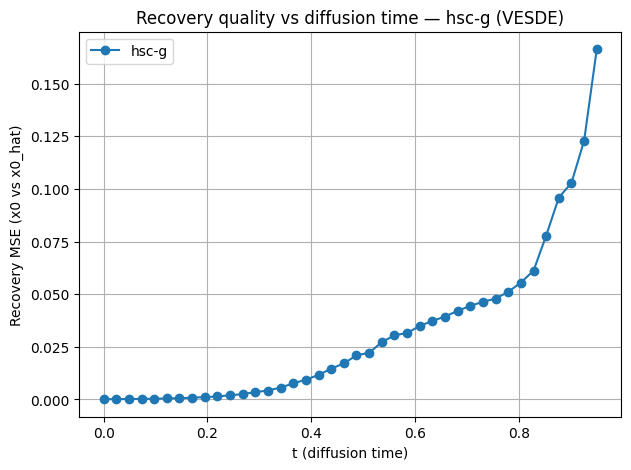

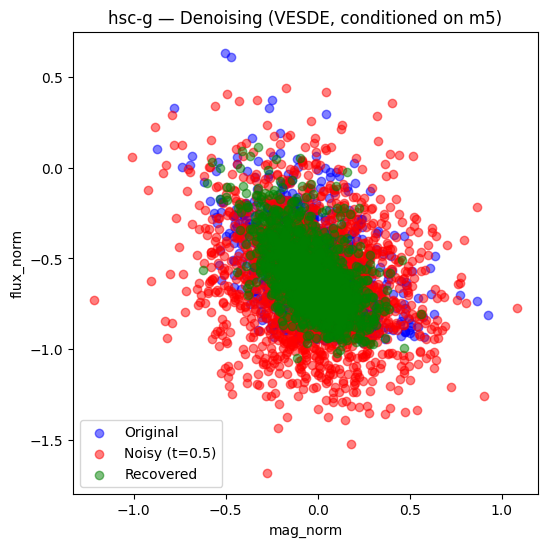

In [53]:
# Pick a band to test
band_name = "hsc-g"

# Extract trained model + test data
score_model = trained_models[band_name]["score_model"]
X_test, C_test = trained_models[band_name]["test_data"]

# --- Recovery curve ---
plot_recovery_curve_for_band(score_model, X_test, C_test, band_name)

# --- Visualize denoising ---
# Take a small random subset for clarity
idx = torch.randperm(X_test.shape[0])[:2000]
visualize_denoising_cond_ve(
    score_model, 
    X_test[idx], 
    C_test[idx], 
    t_value=0.5, 
    sde=sde, 
    title_suffix=band_name
)


# A standard chat-gpt implementation of the function based on the function you sent 

In [49]:
def hist_contour(
    x, y, *,
    w=None,
    bins=60,
    levels=(0.68, 0.95),
    data_range=None,
    smooth_sigma=1.0,
    density=True,
):
    
    try:
        from scipy.ndimage import gaussian_filter as _gauss
    except Exception:
        _gauss = None

    """
    Build a 2D histogram of (x, y) and compute HPD-style density thresholds
    for the given mass levels.

    Returns:
      xc : 1D array of x bin centers
      yc : 1D array of y bin centers
      H  : 2D array (PDF grid) transposed for plt.contour
      thr: strictly increasing list/array of density thresholds
    """
    # 2D histogram / PDF grid
    H, xedges, yedges = np.histogram2d(
        x, y, bins=bins, weights=w, range=data_range, density=density
    )

    # Optional Gaussian smoothing to reduce ties / pixelation
    if smooth_sigma and _gauss is not None:
        H = _gauss(H, smooth_sigma)

    # Bin centers
    xc = 0.5 * (xedges[1:] + xedges[:-1])
    yc = 0.5 * (yedges[1:] + yedges[:-1])

    # Flatten to work with densities
    pdf = H.ravel()
    total = pdf.sum()
    if total <= 0:
        # Degenerate case: return tiny thresholds so contour() won't fail
        eps = 1e-12
        thr = np.array([eps, 2 * eps], dtype=float)
        return xc, yc, H.T, thr

    # HPD thresholds: sort by density (desc), accumulate mass, then pick cut levels
    order = np.argsort(pdf)[::-1]
    pdf_sorted = pdf[order]
    cdf = np.cumsum(pdf_sorted)
    cdf /= cdf[-1]

    thr = []
    for p in levels:
        k = np.searchsorted(cdf, p, side="left")
        k = np.clip(k, 0, len(pdf_sorted) - 1)
        thr.append(pdf_sorted[k])

    # Ensure strictly increasing thresholds for plt.contour
    thr = np.unique(np.sort(np.array(thr, dtype=float)))
    if len(thr) == 1 and len(levels) > 1:
        span = (H.max() - H.min()) or 1.0
        thr = np.array([thr[0] - 1e-6 * span, thr[0] + 1e-6 * span], dtype=float)

    # Transpose so contour(xc, yc, H_T) matches x->cols, y->rows
    return xc, yc, H.T, thr


In [50]:
@torch.no_grad()
def plot_score_model_contours_m5(
    score_model,
    X_samples,            # (N,2) tensor [mag_norm, flux_norm]
    C_samples,            # (N,1) tensor: normalized m5 values
    sde,
    t_value=0.5,
    levels=(0.68, 0.95),  # HPD contour levels
    bins=128,
    smooth_sigma=1.0,
    scatter_alpha=0.15,
    max_points=30000,
    band_name="band",
):
    """
    For a *single-band model conditioned on m5*:
      - Adds VE noise at t=t_value
      - Recovers via Tweedie formula
      - Plots 68/95% HPD contours for Original vs Recovered
    """

    device = next(score_model.parameters()).device
    score_model.eval()

    # --- Subsample for speed ---
    X_samples = X_samples.to(device)
    C_samples = C_samples.to(device)
    if X_samples.shape[0] > max_points:
        idx = torch.randperm(X_samples.shape[0], device=device)[:max_points]
        X_samples = X_samples[idx]
        C_samples = C_samples[idx]

    # --- Forward diffusion (VESDE) ---
    t_vec   = torch.full((X_samples.shape[0],), float(t_value), device=device)
    sigma_t = sde.sigma(t_vec)
    z       = torch.randn_like(X_samples)
    x_t     = X_samples + sigma_t.view(-1, 1) * z

    # --- Tweedie recovery ---
    s       = score_model.score(t_vec, x_t, conditional=C_samples)
    x0_hat  = x_t + (sigma_t.view(-1, 1) ** 2) * s

    # --- Convert to numpy ---
    X0 = X_samples.detach().cpu().numpy()
    XR = x0_hat.detach().cpu().numpy()

    # --- Contours (HPD) ---
    xc_o, yc_o, H_o, thr_o = hist_contour(
        X0[:, 0], X0[:, 1],
        bins=bins, levels=levels, smooth_sigma=smooth_sigma
    )
    xc_r, yc_r, H_r, thr_r = hist_contour(
        XR[:, 0], XR[:, 1],
        bins=bins, levels=levels, smooth_sigma=smooth_sigma
    )

    thr_o = np.sort(np.array(thr_o))
    thr_r = np.sort(np.array(thr_r))

    # --- Plot ---
    plt.figure(figsize=(6.5, 5.5), dpi=120)

    # scatter
    plt.scatter(X0[:, 0], X0[:, 1], s=3, alpha=scatter_alpha, color="gray",  label="Original points")
    plt.scatter(XR[:, 0], XR[:, 1], s=3, alpha=scatter_alpha, color="green", label="Recovered points")

    # contours
    CS1 = plt.contour(xc_o, yc_o, H_o, levels=thr_o, colors=["blue"]*len(thr_o), linewidths=1.6)
    CS2 = plt.contour(xc_r, yc_r, H_r, levels=thr_r, colors=["red"]*len(thr_r),  linewidths=1.6)

    try:
        plt.clabel(CS1, inline=True, fontsize=7, fmt="%.2g")
        plt.clabel(CS2, inline=True, fontsize=7, fmt="%.2g")
    except Exception:
        pass

    import matplotlib.lines as mlines
    lg = [
        mlines.Line2D([], [], color='gray',  marker='o', linestyle='None', markersize=4, label='Original points'),
        mlines.Line2D([], [], color='green', marker='o', linestyle='None', markersize=4, label='Recovered points'),
        mlines.Line2D([], [], color='blue',  label='Original 68/95%'),
        mlines.Line2D([], [], color='red',   label='Recovered 68/95%'),
    ]
    plt.legend(handles=lg, loc="best")

    plt.xlabel("mag_norm")
    plt.ylabel("flux_norm")
    plt.title(f"Original vs Recovered (VESDE, t={t_value}) — {band_name} (cond. on m5)")
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


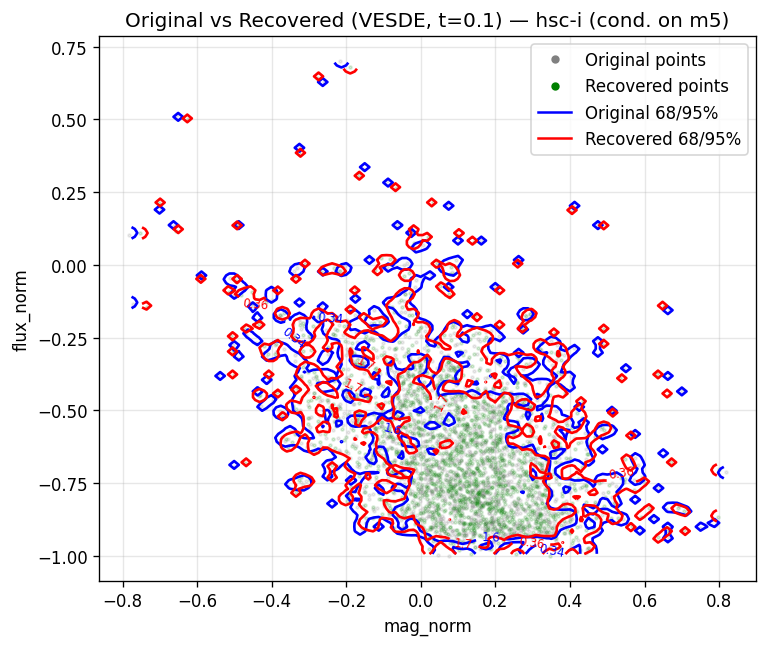

In [63]:
band_name = "hsc-i"
score_model = trained_models[band_name]["score_model"]
X_test, C_test = trained_models[band_name]["test_data"]

plot_score_model_contours_m5(score_model, X_test, C_test, sde, t_value=0.1, band_name=band_name)


# DDIM Generative Model 

In [52]:
@torch.no_grad()
def ddim_generate_conditional_band(pop_model_cond, C_band_all):
    """
    Deterministic generation via probability-flow ODE (DDIM-like).
    Each generated sample uses its own conditional value from C_band_all.
    """
    device = next(pop_model_cond.parameters()).device

    n_samples = C_band_all.shape[0]

    # use the test set conditionals directly
    C = C_band_all.to(device)   # (n_samples, 1)

    # base samples from prior
    base = torch.randn(n_samples, pop_model_cond.model.n_dimensions, device=device)

    # deterministic ODE solve
    X_gen, _ = pop_model_cond.score_model.sample_ode_from_base(base, conditional=C)

    return X_gen.detach().cpu(), C.detach().cpu()



@torch.no_grad()
def plot_generated_vs_real_contours(X_real, X_gen, *,
                                    levels=(0.68, 0.95),
                                    bins=128,
                                    smooth_sigma=1.0,
                                    scatter_alpha=0.15,
                                    title="Band: real vs DDIM-generated"):
    """
    Overlay scatter + 68/95% HPD contours for real vs generated distributions.
    """
    Xr = X_real.detach().cpu().numpy() if torch.is_tensor(X_real) else np.asarray(X_real)
    Xg = X_gen.detach().cpu().numpy()  if torch.is_tensor(X_gen)  else np.asarray(X_gen)

    # Build HPD contours
    xc_r, yc_r, H_r, thr_r = hist_contour(Xr[:,0], Xr[:,1], bins=bins, levels=levels, smooth_sigma=smooth_sigma)
    xc_g, yc_g, H_g, thr_g = hist_contour(Xg[:,0], Xg[:,1], bins=bins, levels=levels, smooth_sigma=smooth_sigma)
    thr_r, thr_g = np.sort(np.array(thr_r)), np.sort(np.array(thr_g))

    plt.figure(figsize=(6.8,5.6), dpi=120)

    # scatter
    nshow_r = min(25000, Xr.shape[0])
    nshow_g = min(25000, Xg.shape[0])
    plt.scatter(Xr[np.random.permutation(Xr.shape[0])[:nshow_r],0],
                Xr[np.random.permutation(Xr.shape[0])[:nshow_r],1],
                s=3, alpha=scatter_alpha, color="gray",  label="Real")
    plt.scatter(Xg[np.random.permutation(Xg.shape[0])[:nshow_g],0],
                Xg[np.random.permutation(Xg.shape[0])[:nshow_g],1],
                s=3, alpha=scatter_alpha, color="green", label="Generated")

    # contours
    plt.contour(xc_r, yc_r, H_r, levels=thr_r, colors=["blue"]*len(thr_r), linewidths=1.6)
    plt.contour(xc_g, yc_g, H_g, levels=thr_g, colors=["red"]*len(thr_g), linewidths=1.6)

    import matplotlib.lines as mlines
    lg = [
        mlines.Line2D([], [], color="gray",  marker="o", linestyle="None", markersize=4, label="Real points"),
        mlines.Line2D([], [], color="green", marker="o", linestyle="None", markersize=4, label="Generated points"),
        mlines.Line2D([], [], color="blue",  label="Real 68/95%"),
        mlines.Line2D([], [], color="red",   label="Gen 68/95%"),
    ]
    plt.legend(handles=lg, loc="best")
    plt.xlabel("mag_norm"); plt.ylabel("flux_norm")
    plt.title(title)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


# To alternate between test_data/ validation_data / training_data here, just change the keyword below

torch.Size([1474, 1])


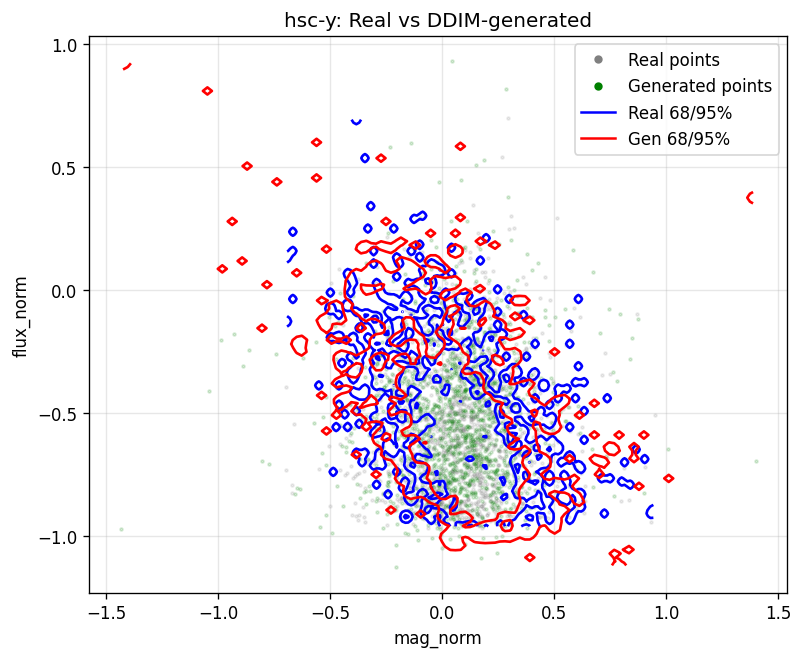

In [53]:
band = "hsc-y"
pop_model_cond = trained_models[band]["pop_model"]   # store PopulationModelDiffusionConditional
Xte_y, Cte_y = trained_models[band]["test_data"]

print(np.shape(Cte_y))

# Generate deterministic samples
X_gen_y, c_used = ddim_generate_conditional_band(pop_model_cond, Cte_y)

# Plot vs real
plot_generated_vs_real_contours(Xte_y, X_gen_y, title=f"{band}: Real vs DDIM-generated")


torch.Size([14735, 1])


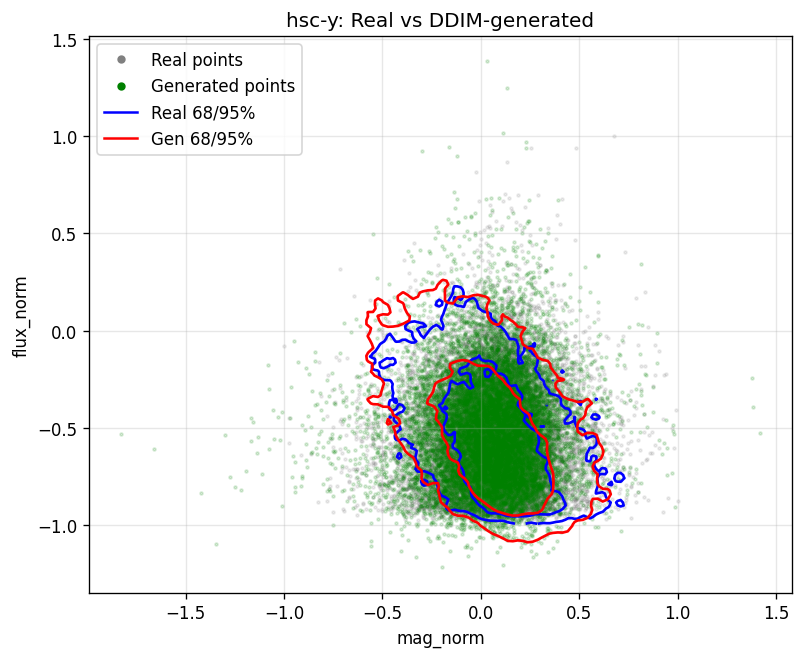

In [55]:
band = "hsc-y"
pop_model_cond = trained_models[band]["pop_model"]   # store PopulationModelDiffusionConditional
X, C = trained_models[band]["data"]

print(np.shape(C))

# Generate deterministic samples
X_gen_y, c_used = ddim_generate_conditional_band(pop_model_cond, C)

# Plot vs real
plot_generated_vs_real_contours(X, X_gen_y, title=f"{band}: Real vs DDIM-generated")


torch.Size([11788, 1])


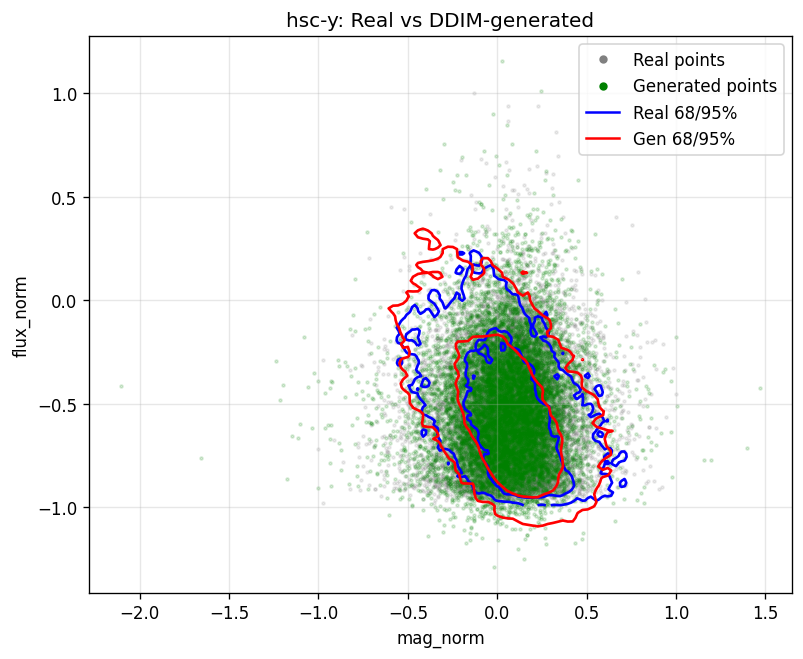

In [56]:
band = "hsc-y"
pop_model_cond = trained_models[band]["pop_model"]   # store PopulationModelDiffusionConditional
X, C = trained_models[band]["training_data"]

print(np.shape(C))

# Generate deterministic samples
X_gen_y, c_used = ddim_generate_conditional_band(pop_model_cond, C)

# Plot vs real
plot_generated_vs_real_contours(X, X_gen_y, title=f"{band}: Real vs DDIM-generated")


In [5]:
band = "hsc-y"
pop_model_cond = trained_models[band]["pop_model"]   # store PopulationModelDiffusionConditional
X, C = trained_models[band]["validation_data"]

print(np.shape(C))

# Generate deterministic samples
X_gen_y, c_used = ddim_generate_conditional_band(pop_model_cond, C)

# Plot vs real
plot_generated_vs_real_contours(X, X_gen_y, title=f"{band}: Real vs DDIM-generated")


NameError: name 'trained_models' is not defined

# DDPM Generative Models

In [127]:
import torch
import numpy as np
import matplotlib.pyplot as plt

@torch.no_grad()
def ddpm_generate_conditional_band(pop_model_cond, C_all, steps=250):
    """
    Stochastic generation via reverse SDE (DDPM-like).
    Uses the built-in sample_sde() from PopulationModelDiffusionConditional.

    Args:
      pop_model_cond : PopulationModelDiffusionConditional (wraps ScoreModel + MLP + SDE)
      C_all          : (N,k) tensor of scaled conditionals (e.g. m5 values for this band)
      steps          : number of Euler–Maruyama steps

    Returns:
      X_gen : (N,2) tensor of generated [mag_norm, flux_norm]
      C_all : (N,k) tensor of conditionals used (aligned with X_gen)
    """
    device = next(pop_model_cond.parameters()).device
    C_all = C_all.to(device)

    n_samples = C_all.shape[0]

    # Directly use the score_model's built-in sampler
    X_gen = pop_model_cond.score_model.sample_sde(
        shape=(n_samples, pop_model_cond.model.n_dimensions),
        conditional=C_all,
        steps=steps
    )

    return X_gen.detach().cpu(), C_all.detach().cpu()


@torch.no_grad()
def plot_ddpm_generated_vs_real(X_real, X_gen, *,
                                levels=(0.68,0.95),
                                bins=128,
                                smooth_sigma=1.0,
                                scatter_alpha=0.15,
                                title="DDPM: Real vs Generated"):
    """
    Compare real vs DDPM-generated samples with scatter + HPD contours.
    Requires `hist_contour`.
    """
    Xr = X_real.detach().cpu().numpy() if torch.is_tensor(X_real) else np.asarray(X_real)
    Xg = X_gen.detach().cpu().numpy()  if torch.is_tensor(X_gen)  else np.asarray(X_gen)

    # Build contours
    xc_r, yc_r, H_r, thr_r = hist_contour(Xr[:,0], Xr[:,1],
                                          bins=bins, levels=levels, smooth_sigma=smooth_sigma)
    xc_g, yc_g, H_g, thr_g = hist_contour(Xg[:,0], Xg[:,1],
                                          bins=bins, levels=levels, smooth_sigma=smooth_sigma)

    thr_r = np.sort(np.array(thr_r)); thr_g = np.sort(np.array(thr_g))

    plt.figure(figsize=(6.8,5.6), dpi=120)
    # light scatter
    nshow_r = min(25000, Xr.shape[0]); nshow_g = min(25000, Xg.shape[0])
    idx_r = np.random.permutation(Xr.shape[0])[:nshow_r]
    idx_g = np.random.permutation(Xg.shape[0])[:nshow_g]
    plt.scatter(Xr[idx_r,0], Xr[idx_r,1], s=3, alpha=scatter_alpha, color="gray",  label="Real")
    plt.scatter(Xg[idx_g,0], Xg[idx_g,1], s=3, alpha=scatter_alpha, color="green", label="DDPM gen")

    # contours
    plt.contour(xc_r, yc_r, H_r, levels=thr_r, colors=["blue"]*len(thr_r), linewidths=1.6)
    plt.contour(xc_g, yc_g, H_g, levels=thr_g, colors=["red"] *len(thr_g), linewidths=1.6)

    import matplotlib.lines as mlines
    lg = [
        mlines.Line2D([], [], color='gray',  marker='o', linestyle='None', markersize=4, label='Real points'),
        mlines.Line2D([], [], color='green', marker='o', linestyle='None', markersize=4, label='Generated points'),
        mlines.Line2D([], [], color='blue',  label='Real 68/95%'),
        mlines.Line2D([], [], color='red',   label='Gen  68/95%'),
    ]
    plt.legend(handles=lg, loc="best")
    plt.xlabel("mag_norm"); plt.ylabel("flux_norm")
    plt.title(title)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()


# Change the key word from "data" to whatever dataset you want to compare

Sampling from the prior | t = 0.0 | sigma = 1.0e-02| scale ~ 9.4e-01: 100%|██████████| 250/250 [00:02<00:00, 97.12it/s] 


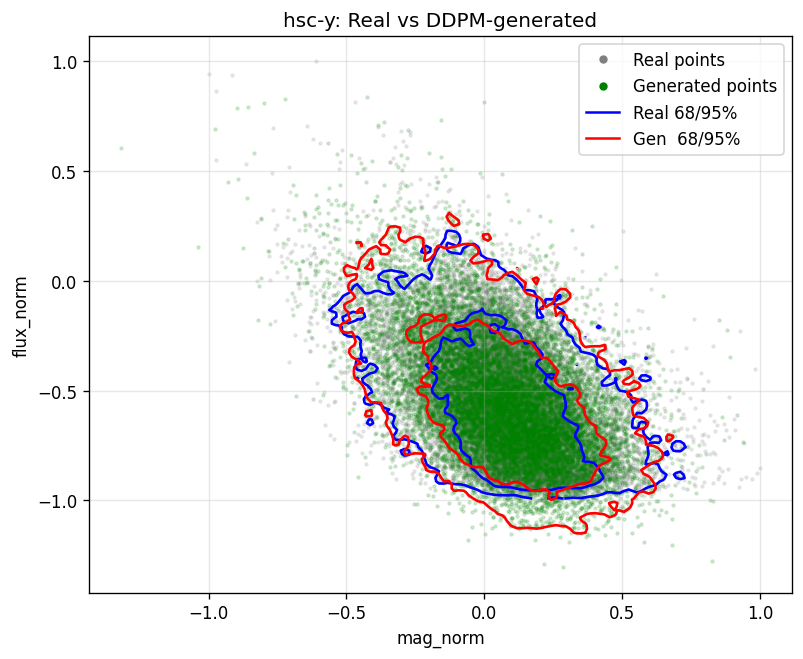

In [ ]:
band = "hsc-y"
pop_model_cond = trained_models[band]["pop_model"]
# Xte_y, Cte_y = trained_models[band]["test_data"]
X, C = trained_models[band]["data"]
# Generate samples with DDPM
X_gen_y, c_used = ddpm_generate_conditional_band(pop_model_cond, C)

# Plot comparison
plot_ddpm_generated_vs_real(X, X_gen_y, title=f"{band}: Real vs DDPM-generated")


# Training the model with the shallowest 0.1 m5 values held out for testing

In [ ]:
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader, random_split
import matplotlib.pyplot as plt

# ========= Dataset class =========
class ArrayDataset(Dataset):
    def __init__(self, X, C):
        self.X = X  # (N,2): [mag_norm, flux_norm]
        self.C = C  # (N,1): m5 condition
    def __len__(self): return self.X.shape[0]
    def __getitem__(self, idx): return self.X[idx], self.C[idx]

# ========= Split by m5 quantile =========
def split_by_m5(X, C, holdout_frac=0.1, val_frac=0.1):
    """
    Hold out lowest `holdout_frac` fraction of m5 for test.
    Then split remaining into train/val.
    """
    m5_vals = C.squeeze().cpu().numpy()
    thresh = np.quantile(m5_vals, holdout_frac)  # cutoff for lowest 10%

    mask_test = m5_vals <= thresh
    mask_rest = ~mask_test

    X_test,  C_test  = X[mask_test],  C[mask_test]
    X_rest,  C_rest  = X[mask_rest],  C[mask_rest]

    # further split into train/val
    n_val = int(val_frac * len(X_rest))
    idxs = torch.randperm(len(X_rest))
    val_idx, train_idx = idxs[:n_val], idxs[n_val:]

    X_val, C_val   = X_rest[val_idx], C_rest[val_idx]
    X_train, C_train = X_rest[train_idx], C_rest[train_idx]

    print(f"Split: train={len(X_train)}  val={len(X_val)}  test={len(X_test)} (thresh={thresh:.3f})")
    return (X_train, C_train), (X_val, C_val), (X_test, C_test)

# ========= Training loop helpers =========
def train_one_epoch(mlp, score_model, loader, optimizer, device):
    mlp.train()
    total = 0.0
    for x0, cond in loader:
        x0, cond = x0.to(device), cond.to(device)
        loss = denoising_score_matching(score_model, x0, conditional=cond)
        optimizer.zero_grad(set_to_none=True)
        loss.backward()
        torch.nn.utils.clip_grad_norm_(mlp.parameters(), 1.0)
        optimizer.step()
        total += loss.item()
    return total / max(1, len(loader))

@torch.no_grad()
def eval_loss(mlp, score_model, loader, device):
    mlp.eval()
    total = 0.0
    for x0, cond in loader:
        x0, cond = x0.to(device), cond.to(device)
        loss = denoising_score_matching(score_model, x0, conditional=cond)
        total += loss.item()
    return total / max(1, len(loader))


# ========= Train one band with early stopping =========
def train_band_model(X_band, C_band, band_name,
                     epochs=200, batch_size=128, lr=1e-3,
                     patience=20, device="cuda"):
    """
    Train model for one band with m5-conditional.
    Hold out lowest 10% m5 for test, split rest into train/val.
    Early stopping on validation loss.
    """
    # Split train/val/test by m5 quantile
    (X_train, C_train), (X_val, C_val), (X_test, C_test) = split_by_m5(
        X_band, C_band, holdout_frac=0.1, val_frac=0.1
    )

    # Wrap in Dataset + Loader
    train_ds = ArrayDataset(X_train, C_train)
    val_ds   = ArrayDataset(X_val, C_val)
    test_ds  = ArrayDataset(X_test, C_test)

    train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True, drop_last=True)
    val_loader   = DataLoader(val_ds,   batch_size=batch_size, shuffle=False)

    # Build model
    mlp = MLP(n_dimensions=2, n_conditionals=1, embedding_dimensions=8,
              units=[128,128], activation=torch.nn.SiLU()).to(device)
    sde = VESDE(sigma_min=1e-2, sigma_max=5.0, T=1.0, epsilon=1e-5).to(device)
    score_model = ScoreModel(model=mlp, sde=sde, no_sigma=False).to(device)

    optimizer = torch.optim.Adam(mlp.parameters(), lr=lr)

    # Early stopping variables
    best_val = float("inf")
    best_state = None
    patience_counter = 0

    print(f"\n==> Training band {band_name} (train={len(train_ds)}, val={len(val_ds)}, test={len(test_ds)})")
    for ep in range(1, epochs+1):
        tr = train_one_epoch(mlp, score_model, train_loader, optimizer, device)
        va = eval_loss(mlp, score_model, val_loader, device)

        if ep % 5 == 0 or ep == 1:
            print(f"[{band_name} ep{ep:03d}] train_loss={tr:.4f} val_loss={va:.4f}")

        # Early stopping check
        if va < best_val - 1e-4:   # require small improvement
            best_val = va
            best_state = {
                "mlp": mlp.state_dict(),
                "optimizer": optimizer.state_dict(),
                "epoch": ep,
            }
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"⏹️ Early stopping at epoch {ep} (no val improvement for {patience} epochs).")
                break

    # Load best state back into model
    if best_state is not None:
        mlp.load_state_dict(best_state["mlp"])
        print(f"✅ Restored best model from epoch {best_state['epoch']} (val_loss={best_val:.4f})")

    return mlp, score_model, (X_train, C_train), (X_val, C_val), (X_test, C_test), sde


# ========= Train all bands =========
trained_models_high_m5 = {}
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for band, data in normalized_data.items():
    X = torch.tensor(np.vstack([data["mags_norm"], data["flux_norm"]]).T, dtype=torch.float32)
    C = torch.tensor(np.array(data["m5_norm"]).reshape(-1,1), dtype=torch.float32)  # must have m5 normalized per sample!

    mlp, score_model, train_data, val_data, test_data, sde = train_band_model(
        X, C, band, epochs=50, batch_size=128, lr=1e-3, device=device
    )

    # Wrap into PopulationModelDiffusionConditional
    pop_model_cond = PopulationModelDiffusionConditional(
        model=mlp, sde=sde, no_sigma=False
    ).to(device)

    trained_models_high_m5[band] = {
        "mlp": mlp,
        "score_model": score_model,
        "pop_model": pop_model_cond,
        "training_data": train_data,
        "validation_data": val_data,
        "test_data": test_data,
        "data": (X,C) 
    }

print("\n✅ Finished training all bands with train/val/test + population model.")


Split: train=10977  val=1219  test=1359 (thresh=0.088)

==> Training band cfht-u (train=10977, val=1219, test=1359)
[cfht-u ep001] train_loss=1.3640 val_loss=1.2722
[cfht-u ep005] train_loss=1.1283 val_loss=1.0755
[cfht-u ep010] train_loss=1.0700 val_loss=1.0492
[cfht-u ep015] train_loss=1.0300 val_loss=1.0826
[cfht-u ep020] train_loss=1.0330 val_loss=0.9922
[cfht-u ep025] train_loss=0.9952 val_loss=0.9656
[cfht-u ep030] train_loss=1.0002 val_loss=0.9671
[cfht-u ep035] train_loss=0.9808 val_loss=1.0137
[cfht-u ep040] train_loss=0.9804 val_loss=0.9650
[cfht-u ep045] train_loss=0.9834 val_loss=1.0987
[cfht-u ep050] train_loss=0.9424 val_loss=0.9712
✅ Restored best model from epoch 34 (val_loss=0.9008)
Split: train=12636  val=1404  test=1566 (thresh=-0.176)

==> Training band hsc-g (train=12636, val=1404, test=1566)
[hsc-g ep001] train_loss=1.3741 val_loss=1.2326
[hsc-g ep005] train_loss=1.0758 val_loss=1.0346
[hsc-g ep010] train_loss=1.0514 val_loss=1.0314
[hsc-g ep015] train_loss=1.0116

# Save and load the models / metadata

In [ ]:
import torch

# Save each model's state_dict and metadata
save_dict = {}
for band, entry in trained_models_high_m5.items():
    save_dict[band] = {
        "mlp_state": entry["mlp"].state_dict(),
        "score_model_state": entry["score_model"].state_dict(),
        "pop_model_state": entry["pop_model"].state_dict(),
        # tensors and splits can be stored directly (since they are small)
        "test_data": entry["test_data"],
        "data": entry["data"],
        "validation_data": entry["validation_data"],
        "training_data": entry["training_data"],
    }

torch.save(save_dict, "trained_models2.pth")
print("✅ Saved trained_models to trained_models2.pth")


✅ Saved trained_models to trained_models.pth


In [72]:
# Rebuild the same structure
checkpoint = torch.load("trained_models2.pth", map_location=device)

trained_models_high_m5_2 = {}
for band, entry in checkpoint.items():
    # Rebuild model & score_model
    mlp = MLP(
        n_dimensions=2,
        n_conditionals=1,
        embedding_dimensions=8,
        units=[128, 128],
        activation=torch.nn.SiLU(),
        sigma_initialization=16,
    ).to(device)

    sde = VESDE(sigma_min=1e-2, sigma_max=5.0, T=1.0, epsilon=1e-5).to(device)

    score_model = ScoreModel(model=mlp, sde=sde, no_sigma=False, hutchinson=False).to(device)
    pop_model_cond = PopulationModelDiffusionConditional(
        model=mlp, sde=sde, no_sigma=False
    ).to(device)

    # Load weights
    mlp.load_state_dict(entry["mlp_state"])
    score_model.load_state_dict(entry["score_model_state"])
    pop_model_cond.load_state_dict(entry["pop_model_state"])

    # Restore dict
    trained_models_high_m5_2[band] = {
        "mlp": mlp,
        "score_model": score_model,
        "pop_model": pop_model_cond,
        "test_data": entry["test_data"],
        "data": entry["data"],
        "validation_data": entry["validation_data"],
        "training_data": entry["training_data"],
    }

print("✅ Reloaded trained_models from trained_models2.pth")


✅ Reloaded trained_models from trained_models2.pth


In [73]:
compare_trained_models(trained_models_high_m5,trained_models_high_m5_2)

✅ All models, weights, and data match exactly.


True

# DDPM because DDPM has better results 

# Change the keyword from test_data to whatever dataset you want to compare

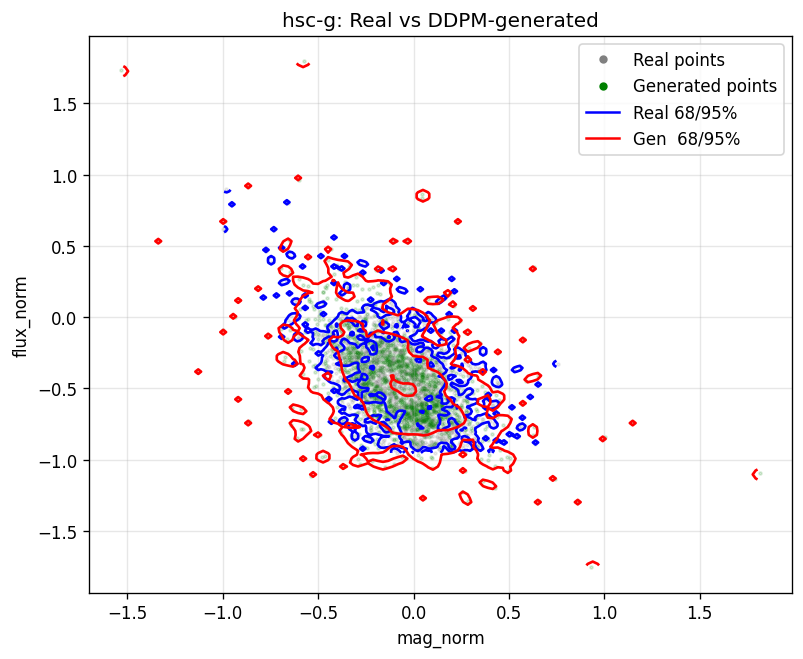

In [82]:


band = "hsc-g"
pop_model_cond = trained_models_high_m5[band]["pop_model"]
Xte_y, Cte_y = trained_models_high_m5[band]["test_data"]

# Generate samples with DDPM
X_gen_y, c_used = ddim_generate_conditional_band(pop_model_cond, Cte_y)

# Plot comparison
plot_ddpm_generated_vs_real(Xte_y, X_gen_y, title=f"{band}: Real vs DDPM-generated")


In [115]:
def reverse_transform_m5(C_norm, m5_min, m5_max):
    """
    Reverse transform normalized m5 values back to original scale.
    C_norm: (N,1) tensor in [-1,1]
    m5_min, m5_max: original min/max
    """
    C_orig = (C_norm.squeeze().cpu().numpy() + 1) * 0.5 * (m5_max - m5_min) + m5_min
    return C_orig


def normalize_single_m5(m5_value, m5_min, m5_max):
    """
    Normalize a single m5 value to [-1, 1].

    Args:
      m5_value : float, raw m5 value
      m5_min   : float, minimum m5 in dataset
      m5_max   : float, maximum m5 in dataset

    Returns:
      float: normalized m5 in [-1,1]
    """
    return 2 * (m5_value - m5_min) / (m5_max - m5_min) - 1


In [ ]:
def select_by_conditional_band(X, C, center, width, band_ranges):
    """
    Select samples based on conditional (m5) values around a given center band.

    Args:
      X      : (N,2) tensor of samples [mag_norm, flux_norm]
      C      : (N,1) tensor of conditionals (m5_norm)
      center : float — center of selection band
      width  : float — half-width of selection band (absolute)

    Returns:
      X_sel, C_sel : filtered tensors
    """

    # get original normalization params (assuming you stored them in band_ranges or similar)
    m5_min = band_ranges[band]["m5_min"]
    m5_max = band_ranges[band]["m5_max"]

    center_val = normalize_single_m5(float(center), m5_min=m5_min, m5_max = m5_max)

    # Build mask
    lower = center_val - width
    upper = center_val + width
    mask = (C.squeeze() >= lower) & (C.squeeze() <= upper)

    # Filter
    X_sel = X[mask]
    C_sel = C[mask]

    print(f"Center = {center_val:.3f}, Width = ±{width}, "
          f"Selected {len(X_sel)} samples in [{lower:.3f}, {upper:.3f}]")

    return X_sel, C_sel



# Just a scrappy diagnostic of the m5 values and its distribution - nbins should not be the same for the two plots

(array([  1.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   5.,   0.,   0.,   0.,   1.,   0.,
          2.,   0.,   1.,  10.,   1.,   4.,   8.,  15.,   6.,  22.,   9.,
          9.,  12.,  15.,  30.,  42.,  29.,  65.,  75.,  68.,  43.,  65.,
         91., 133., 136., 167., 225., 183.]),
 array([24.373703  , 24.39744377, 24.42118454, 24.44492531, 24.46866608,
        24.49240685, 24.51614761, 24.53988838, 24.56362915, 24.58736992,
        24.61111069, 24.63485146, 24.65859222, 24.6823349 , 24.70607567,
        24.72981644, 24.75355721, 24.77729797, 24.80103874, 24.82477951,
        24.84852028, 24.87226105, 24.89600182, 24.91974258, 24.94348335,
        24.96722412, 24.99096489, 25.01470566, 25.03844643, 25.06218719,
        25.08592796, 25.10966873, 25.1334095 , 25.15715027, 25.18089104,
        25.20463181, 25.22837257, 25.25211334, 25.27585602, 25.29959679,
        25.32333755, 25.34707832, 25.37081909, 25.39455986, 25.41830063,
 

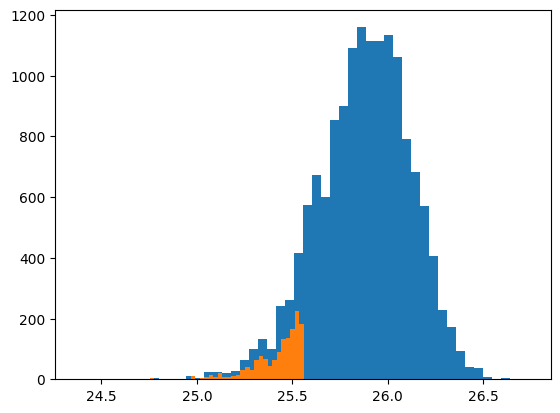

In [ ]:

band = "hsc-y"
pop_model_cond = trained_models_high_m5[band]["pop_model"]
X, C = trained_models_high_m5[band]["data"]



C = reverse_transform_m5(C, m5_min, m5_max)


plt.hist(C, bins = 50)

band = "hsc-y"
pop_model_cond = trained_models_high_m5[band]["pop_model"]
X, C = trained_models_high_m5[band]["test_data"]

# get original normalization params (assuming you stored them in band_ranges or similar)
m5_min = band_ranges[band]["m5_min"]
m5_max = band_ranges[band]["m5_max"]

C = reverse_transform_m5(C, m5_min, m5_max)
plt.hist(C, bins = 50)


# Slicing at specific m5 values

Center = 0.376, Width = ±0.3, Selected 11901 samples in [0.076, 0.676]


Sampling from the prior | t = 0.0 | sigma = 1.0e-02| scale ~ 1.2e+00: 100%|██████████| 250/250 [00:03<00:00, 69.55it/s]


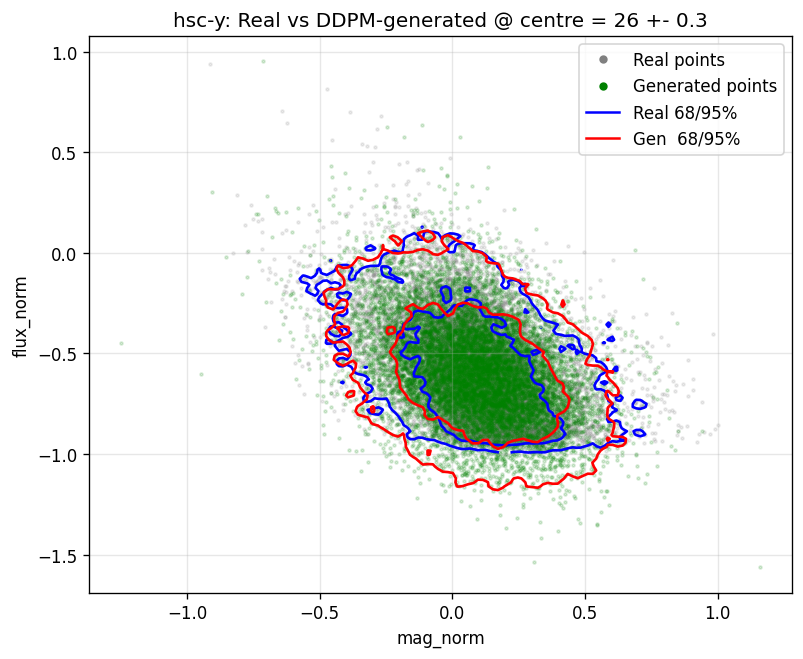

In [134]:

band = "hsc-y"
pop_model_cond = trained_models_high_m5[band]["pop_model"]
X, C = trained_models_high_m5[band]["data"]

centre, width = 26, 0.3

Xs, Cs = select_by_conditional_band(X, C, centre , width, band_ranges=band_ranges)

# Generate samples with DDPM
X_gen_y, c_used = ddpm_generate_conditional_band(pop_model_cond, Cs)

# Plot comparison
plot_ddpm_generated_vs_real(Xs, X_gen_y, title=f"{band}: Real vs DDPM-generated @ centre = {centre} +- {width}")
